In [1]:
cd F:\PROJECTS\PROJECT_MONKEY SC-RNA SEQ\WORKPLACE\R\

F:\PROJECTS\PROJECT_MONKEY SC-RNA SEQ\WORKPLACE\R


G:\Miniconda3\envs\scvi-env\lib\site-packages\IPython\core\magics\osm.py:417: UserWarning: using dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


In [3]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import os
import sys
import scipy
import anndata


plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
plt.rcParams["font.family"] = "Arial"

sc.set_figure_params(figsize=(4, 4))
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 600, vector_friendly = True, format = 'pdf')
palette = ['#fbbc04', '#199de5', '#cfe6d5']

In [4]:
def Barplot(which_var, adata, var='clusters', height=3, color = False):
    plotdata = pd.crosstab(adata.obs[var], adata.obs[which_var], normalize='index') * 100
    if 'category' in plotdata.index.dtype.name:
        plotdata.index.reorder_categories(adata.obs[var].cat.categories[::-1])

    if not color:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False)
    else:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False, color = color)
    ax1.set_title(which_var+' %')
    ax1.set_ylabel(var)
    horiz_offset = 1
    vert_offset = 1.
    ax1 = ax1.legend(bbox_to_anchor = (horiz_offset, vert_offset))
#     ax1.figure.savefig(str(sc.settings.figdir)+'/barplot_'+var+'_proportions_'+which_var+'.pdf', bbox_inches='tight',
#                        dpi=300, orientation='landscape', format= 'pdf', optimize=True)

In [5]:
import os
import tempfile
import scanpy as sc
import scvi
import seaborn as sns
import torch

In [6]:
scvi.settings.seed = 0
print("Last run with scvi-tools version:", scvi.__version__)

Seed set to 0


Last run with scvi-tools version: 1.1.2


In [7]:
import scanpy as sc
sc.set_figure_params()
macaque_gc=sc.read_h5ad("Mac_gc_python.h5ad")
macaque_gc

AnnData object with n_obs × n_vars = 2800 × 15315
    obs: 'nCount_RNA', 'nFeature_RNA', 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'batch', 'age', 'cluster3', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.8', 'seurat_clusters', 'integrated_snn_res.0.4', 'integrated_snn_res.0.3', 'seurat_clusters.new', 'celltype', 'celltype_species'
    var: 'name'
    obsm: 'X_pca', 'X_umap'

In [8]:
import scanpy as sc
sc.set_figure_params()
mouse_gc=sc.read_h5ad("Mm_gc_python.h5ad")
mouse_gc

AnnData object with n_obs × n_vars = 120 × 15338
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'pHB', 'pRP', 'pMT', 'nCount_SCT', 'nFeature_SCT', 'seurat_clusters', 'SCT_snn_res.1.2', 'celltype', 'celltype_species'
    var: 'name'
    obsm: 'X_pca', 'X_umap'

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


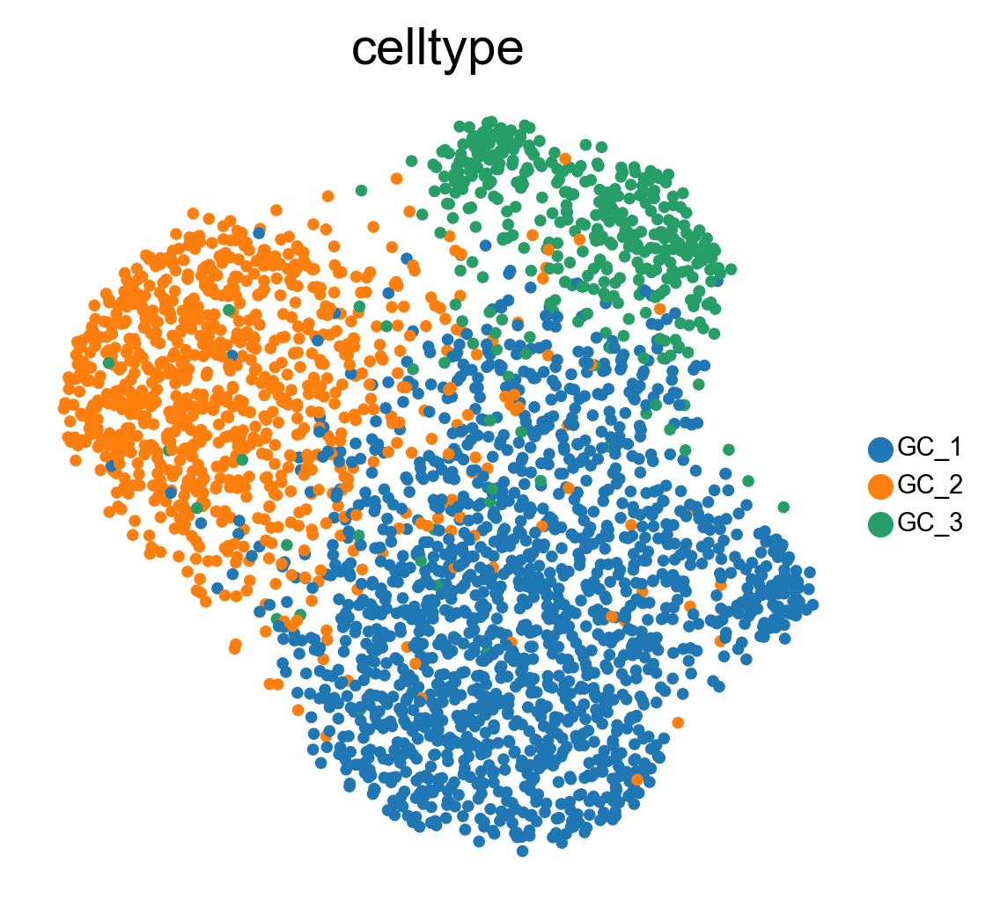

In [11]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(macaque_gc,color=['celltype'],frameon=False, legend_fontsize=7, 
           legend_fontoutline=False
          
          )

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


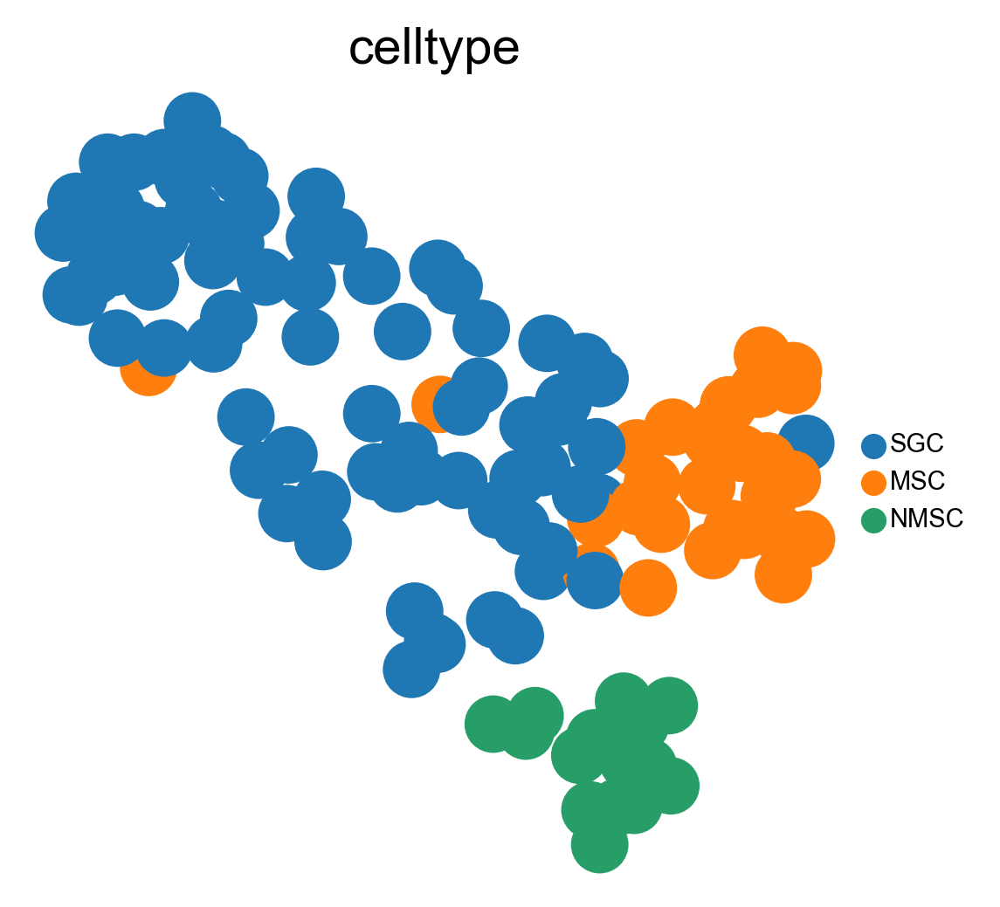

In [12]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(mouse_gc,color=['celltype'],frameon=False, legend_fontsize=7, 
           legend_fontoutline=False
          
          )

In [14]:
macaque_gc.layers["counts"] = macaque_gc.X.copy() 
macaque_gc.layers['counts']

<2800x15315 sparse matrix of type '<class 'numpy.float64'>'
	with 3347859 stored elements in Compressed Sparse Column format>

In [15]:
mouse_gc.layers["counts"] = mouse_gc.X.copy() 
mouse_gc.layers['counts']

<120x15338 sparse matrix of type '<class 'numpy.float64'>'
	with 154986 stored elements in Compressed Sparse Column format>

In [16]:
macaque_gc.X = macaque_gc.layers["counts"].copy()
sc.pp.normalize_total(macaque_gc)
sc.pp.log1p(macaque_gc)
macaque_gc.layers["logcounts"] = macaque_gc.X.copy()

In [17]:
mouse_gc.X = mouse_gc.layers["counts"].copy()
sc.pp.normalize_total(mouse_gc)
sc.pp.log1p(mouse_gc)
mouse_gc.layers["logcounts"] = mouse_gc.X.copy()

In [18]:
mouse_gc

AnnData object with n_obs × n_vars = 120 × 15338
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'pHB', 'pRP', 'pMT', 'nCount_SCT', 'nFeature_SCT', 'seurat_clusters', 'SCT_snn_res.1.2', 'celltype', 'celltype_species'
    var: 'name'
    uns: 'celltype_colors', 'log1p'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts', 'logcounts'

In [19]:
macaque_gc

AnnData object with n_obs × n_vars = 2800 × 15315
    obs: 'nCount_RNA', 'nFeature_RNA', 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'batch', 'age', 'cluster3', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.8', 'seurat_clusters', 'integrated_snn_res.0.4', 'integrated_snn_res.0.3', 'seurat_clusters.new', 'celltype', 'celltype_species'
    var: 'name'
    uns: 'celltype_colors', 'log1p'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts', 'logcounts'

In [20]:
marker_genes = [
    *["LRP1","CLU","PROS1","AXL","MEGF10","MERTK","ITGAV","GULP1"], #GENES RELATED TO CLEARANCE
    *["GLUL","SLC7A11","SLC44A3","SLC44A5","CRYAB"],#NT TRANSPORT AND SYNTHESIS
    *["CNTN1","RDX","EPB41L3"],# PARANODAL FUNCTION
    *["DPP10","ATP1B1","ATP1A1","ATP1A2","KCNQ5","KCNMA1","KCNIP4", "KCNJ10"],#POTASSIUM BUFFERING
    *["GRIA2", "GRIK2", "GABRG3"],#NEUROTRANSMITTER RECEPTOR
    *["FGF1","BMP7"],#MORPHOGEN
    *["GPC5","SPARC","SPARCL1"],#SYNAPSE FORMATION    
]

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


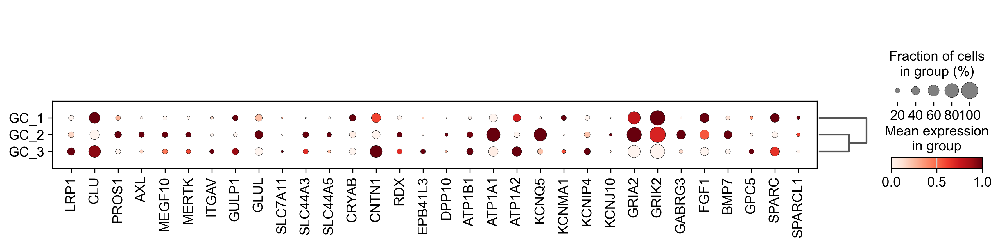

In [21]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(macaque_gc, groupby="celltype")
sc.pl.dotplot(macaque_gc, marker_genes, groupby="celltype",standard_scale="var",
             dendrogram=True)

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


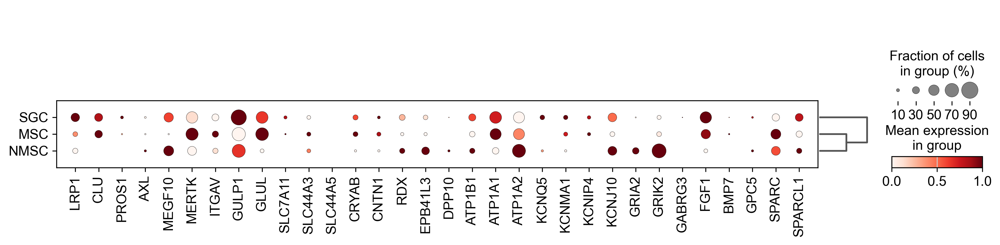

In [22]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(mouse_gc, groupby="celltype")
sc.pl.dotplot(mouse_gc, marker_genes, groupby="celltype",standard_scale="var",
             dendrogram=True)

In [23]:
gc_combined=macaque_gc.concatenate(mouse_gc)

C:\Users\Dell\AppData\Local\Temp\ipykernel_2664\1304502673.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  gc_combined=macaque_gc.concatenate(mouse_gc)


In [24]:
gc_combined

AnnData object with n_obs × n_vars = 2920 × 13495
    obs: 'nCount_RNA', 'nFeature_RNA', 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'batch', 'age', 'cluster3', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.8', 'seurat_clusters', 'integrated_snn_res.0.4', 'integrated_snn_res.0.3', 'seurat_clusters.new', 'celltype', 'celltype_species', 'orig.ident', 'pHB', 'pRP', 'pMT', 'SCT_snn_res.1.2'
    var: 'name'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts', 'logcounts'

In [26]:
sc.pp.normalize_total(gc_combined)
sc.pp.log1p(gc_combined)

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


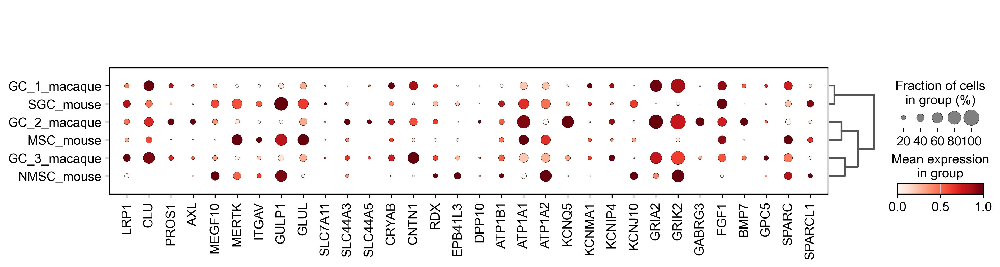

In [27]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(gc_combined, groupby="celltype_species")
sc.pl.dotplot(gc_combined, marker_genes, groupby="celltype_species",standard_scale="var",
             dendrogram=True)

In [43]:
small_marker_dict={'GENES RELATED TO CLEARANCE':["LRP1","CLU","PROS1","AXL","MEGF10","MERTK","ITGAV","GULP1"],
                  'NT TRANSPORT AND SYNTHESIS':["GLUL","SLC7A11","SLC44A3","SLC44A5","CRYAB"], 
'PARANODAL FUNCTION':["CNTN1","RDX","EPB41L3"],
'POTASSIUM BUFFERING':["DPP10","ATP1B1","ATP1A1","ATP1A2","KCNQ5","KCNMA1","KCNIP4", "KCNJ10"],
  'NEUROTRANSMITTER RECEPTOR':["GRIA2", "GRIK2", "GABRG3"],   
      'MORPHOGEN':["FGF1","BMP7"],
       'SYNAPSE FORMATION':["GPC5","SPARC","SPARCL1"],
}

# check if the markers are in the data
smarker_genes_in_data = dict()
for ct, markers in small_marker_dict.items():
    markers_found = list()
    for marker in markers:
        if marker in gc_combined.var.index:
            markers_found.append(marker)
    smarker_genes_in_data[ct] = markers_found
#del [] # remove the last marker
del_markers = list()
for ct, markers in smarker_genes_in_data.items():
    if markers==[]:
        del_markers.append(ct)
for ct in del_markers:
    del smarker_genes_in_data[ct]

In [44]:
smarker_genes_in_data

{'GENES RELATED TO CLEARANCE': ['LRP1',
  'CLU',
  'PROS1',
  'AXL',
  'MEGF10',
  'MERTK',
  'ITGAV',
  'GULP1'],
 'NT TRANSPORT AND SYNTHESIS': ['GLUL',
  'SLC7A11',
  'SLC44A3',
  'SLC44A5',
  'CRYAB'],
 'PARANODAL FUNCTION': ['CNTN1', 'RDX', 'EPB41L3'],
 'POTASSIUM BUFFERING': ['DPP10',
  'ATP1B1',
  'ATP1A1',
  'ATP1A2',
  'KCNQ5',
  'KCNMA1',
  'KCNIP4',
  'KCNJ10'],
 'NEUROTRANSMITTER RECEPTOR': ['GRIA2', 'GRIK2', 'GABRG3'],
 'MORPHOGEN': ['FGF1', 'BMP7'],
 'SYNAPSE FORMATION': ['GPC5', 'SPARC', 'SPARCL1']}

In [45]:
gc_combined.obs['celltype_species'].cat.reorder_categories(['GC_1_macaque', 
                                                         'GC_2_macaque', 'GC_3_macaque',
                                                         'SGC_mouse', 'MSC_mouse', 'NMSC_mouse',
                                                         ], inplace=True)

C:\Users\Dell\AppData\Local\Temp\ipykernel_2664\1328013383.py:1: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  gc_combined.obs['celltype_species'].cat.reorder_categories(['GC_1_macaque',


G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


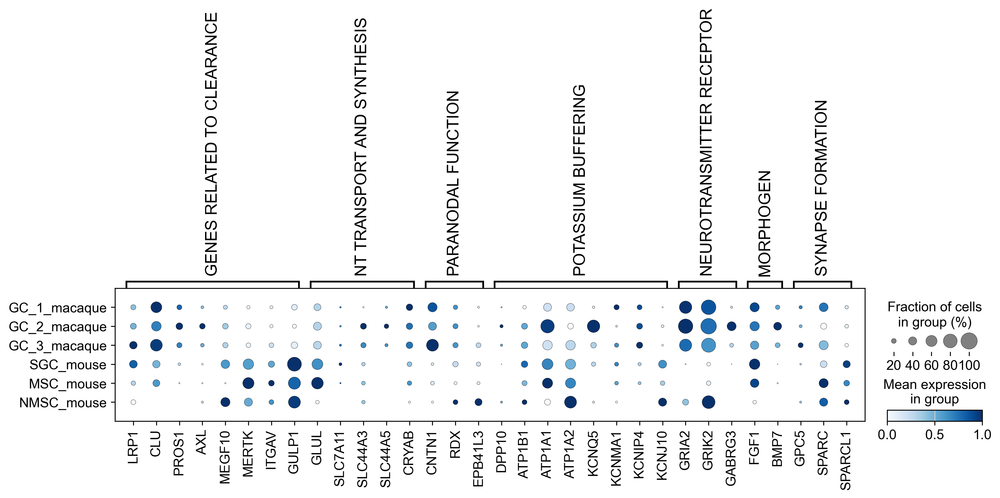

In [46]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    gc_combined,
    groupby="celltype_species",
    var_names=smarker_genes_in_data,
   #dendrogram=True,
    cmap='Blues',
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
     save="_glia_cells_macaque_mouse_selective_markers.pdf"
)

RUN MULTI-DISPLINTARY INTEGRATION METHODS TO test the species differences of glial cells between mouse and macaque

In [47]:
import torch
scvi.settings.seed = 0
print("Last run with scvi-tools version:", scvi.__version__)

Seed set to 0


Last run with scvi-tools version: 1.1.2


In [48]:
# Python packages
import scanpy as sc
import bbknn
import scib
import numpy as np
import pandas as pd

In [52]:
mouse_gc.obs['species']='mouse'

In [53]:
macaque_gc.obs['species']='macaque'

In [54]:
gc_combined=macaque_gc.concatenate(mouse_gc)

C:\Users\Dell\AppData\Local\Temp\ipykernel_2664\1304502673.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  gc_combined=macaque_gc.concatenate(mouse_gc)
G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\dtypes\cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])


In [57]:
sc.pp.normalize_total(gc_combined, target_sum=1e4)
sc.pp.log1p(gc_combined)
#sc.pp.scale(adata)
gc_combined.layers["logcounts"] = gc_combined.X.copy()
gc_combined.layers['logcounts']
gc_combined

AnnData object with n_obs × n_vars = 2920 × 13495
    obs: 'nCount_RNA', 'nFeature_RNA', 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'batch', 'age', 'cluster3', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.8', 'seurat_clusters', 'integrated_snn_res.0.4', 'integrated_snn_res.0.3', 'seurat_clusters.new', 'celltype', 'celltype_species', 'species', 'orig.ident', 'pHB', 'pRP', 'pMT', 'SCT_snn_res.1.2'
    var: 'name'
    uns: 'species_colors', 'log1p'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts', 'logcounts'

RUN MULTI-DISPLINTARY INTEGRATION METHODS TO test species' differences between mice and macaques

In [133]:
import torch
scvi.settings.seed = 0
print("Last run with scvi-tools version:", scvi.__version__)

Seed set to 0


Last run with scvi-tools version: 1.1.2


In [134]:
# Python packages
import scanpy as sc
import bbknn
import scib
import numpy as np
import pandas as pd

In [135]:
sc.pp.normalize_total(gc_combined, target_sum=1e4)
sc.pp.log1p(gc_combined)
#sc.pp.scale(adata)
gc_combined.layers["logcounts"] = gc_combined.X.copy()
gc_combined.layers['logcounts']
gc_combined

AnnData object with n_obs × n_vars = 2920 × 2000
    obs: 'nCount_RNA', 'nFeature_RNA', 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'batch', 'age', 'cluster3', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.8', 'seurat_clusters', 'integrated_snn_res.0.4', 'integrated_snn_res.0.3', 'seurat_clusters.new', 'celltype', 'celltype_species', 'species', 'orig.ident', 'pHB', 'pRP', 'pMT', 'SCT_snn_res.1.2', '_scvi_batch', '_scvi_labels', 'celltype_scanvi', 'C_scANVI'
    var: 'name', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_rank', 'variances', 'variances_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'species_colors', 'log1p', 'hvg', 'pca', 'neighbors', '

In [136]:
sc.pp.highly_variable_genes(gc_combined)
sc.tl.pca(gc_combined)
sc.pp.neighbors(gc_combined)
sc.tl.leiden(gc_combined)
sc.tl.umap(gc_combined)
gc_combined

G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\dtypes\cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated 

AnnData object with n_obs × n_vars = 2920 × 2000
    obs: 'nCount_RNA', 'nFeature_RNA', 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'batch', 'age', 'cluster3', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.8', 'seurat_clusters', 'integrated_snn_res.0.4', 'integrated_snn_res.0.3', 'seurat_clusters.new', 'celltype', 'celltype_species', 'species', 'orig.ident', 'pHB', 'pRP', 'pMT', 'SCT_snn_res.1.2', '_scvi_batch', '_scvi_labels', 'celltype_scanvi', 'C_scANVI'
    var: 'name', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_rank', 'variances', 'variances_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'species_colors', 'log1p', 'hvg', 'pca', 'neighbors', '

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\_settings.py:450: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


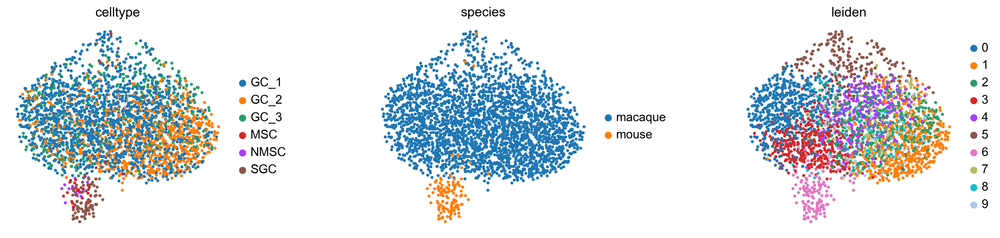

In [137]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(gc_combined, color=['celltype','species','leiden'], wspace=0.5)

In [138]:
sc.pp.highly_variable_genes(
    gc_combined, n_top_genes=2000, flavor="seurat_v3", batch_key='species'
)
gc_combined
gc_combined.var

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\preprocessing\_highly_variable_genes.py:64: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


,name,highly_variable,means,dispersions,dispersions_norm,highly_variable_rank,variances,variances_norm,highly_variable_nbatches,highly_variable_intersection
WDR64,WDR64,True,0.179538,4.056448,-0.029253,1404.0,0.677286,0.501874,2,False
GREM2,GREM2,True,0.053134,4.215179,1.475708,1000.0,0.215972,0.520148,2,False
CHRM3,CHRM3,True,0.101591,4.075424,0.000536,994.5,0.390097,0.998666,2,True
B3GALNT2,B3GALNT2,True,0.682732,3.918678,-0.411118,878.5,2.227780,1.011217,2,True
IRF2BP2,IRF2BP2,True,0.085545,4.052900,-0.599264,1295.0,0.325737,0.998757,2,True
...,...,...,...,...,...,...,...,...,...,...
NDUFS6,NDUFS6,True,0.234856,4.034203,-0.214143,1267.5,0.865548,0.987027,2,True
MAP4K2,MAP4K2,True,0.069216,4.105506,0.298078,966.5,0.267684,1.013129,2,True
RARRES2,RARRES2,True,0.365810,4.050067,1.121971,304.5,1.321454,1.110309,2,True
CCDC186,CCDC186,True,0.436508,3.939368,-1.316564,1262.5,1.516025,0.998223,2,True


In [139]:
n_batches = gc_combined.var["highly_variable_nbatches"].value_counts()
n_batches
adata_hvg = gc_combined[:, gc_combined.var["highly_variable"]].copy()
adata_hvg

AnnData object with n_obs × n_vars = 2920 × 2000
    obs: 'nCount_RNA', 'nFeature_RNA', 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'batch', 'age', 'cluster3', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.8', 'seurat_clusters', 'integrated_snn_res.0.4', 'integrated_snn_res.0.3', 'seurat_clusters.new', 'celltype', 'celltype_species', 'species', 'orig.ident', 'pHB', 'pRP', 'pMT', 'SCT_snn_res.1.2', '_scvi_batch', '_scvi_labels', 'celltype_scanvi', 'C_scANVI'
    var: 'name', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_rank', 'variances', 'variances_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'species_colors', 'log1p', 'hvg', 'pca', 'neighbors', '

In [140]:
adata_scvi = adata_hvg.copy()
scvi.model.SCVI.setup_anndata(adata_scvi, layer="counts", batch_key='species',) 
adata_scvi

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\data\fields\_base_field.py:64: UserWarning: adata.layers[counts] does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


AnnData object with n_obs × n_vars = 2920 × 2000
    obs: 'nCount_RNA', 'nFeature_RNA', 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'batch', 'age', 'cluster3', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.8', 'seurat_clusters', 'integrated_snn_res.0.4', 'integrated_snn_res.0.3', 'seurat_clusters.new', 'celltype', 'celltype_species', 'species', 'orig.ident', 'pHB', 'pRP', 'pMT', 'SCT_snn_res.1.2', '_scvi_batch', '_scvi_labels', 'celltype_scanvi', 'C_scANVI'
    var: 'name', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_rank', 'variances', 'variances_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'species_colors', 'log1p', 'hvg', 'pca', 'neighbors', '

In [141]:
vae = scvi.model.SCVI(adata_scvi, n_layers=3, n_latent=30)
vae

SCVI model with the following parameters: 
n_hidden: 128, n_latent: 30, n_layers: 3, dropout_rate: 0.1, dispersion: gene, gene_likelihood: zinb, 
latent_distribution: normal.
Training status: Not Trained
Model's adata is minified?: False

In [142]:
vae.view_anndata_setup()

Anndata setup with scvi-tools version 1.1.2.

Setup via `SCVI.setup_anndata` with arguments:

{
│   'layer': 'counts',
│   'batch_key': 'species',
│   'labels_key': None,
│   'size_factor_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   2   │
│         n_cells          │ 2920  │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
│         n_labels         │   1   │
│          n_vars          │ 2000  │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │  adata.layers['counts']   │
│    batch     │ adata.obs['_scvi_batch']  │
│    labels    │ adata.obs['_scvi_labels'] │
└──────────────┴───────────────────────────┘

                   batch State Registry                    
┏━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃   Source Location    ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['species'] │  macaque   │          0          │
│                      │   mouse    │          1          │
└──────────────────────┴────────────┴─────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

In [143]:
max_epochs_scvi = np.min([round((20000 / adata_scvi.n_obs) * 400), 400])
max_epochs_scvi

400

In [144]:
vae.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
G:\Miniconda3\envs\scvi-env\lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=47` in the `DataLoader` to improve performance.


Epoch 1/400:   0%|                               | 0/400 [00:00<?, ?it/s]

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 2/400:   0%| | 1/400 [00:00<04:03,  1.64it/s, v_num=1, train_loss_s

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 3/400:   0%| | 2/400 [00:01<03:58,  1.67it/s, v_num=1, train_loss_s

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 4/400:   1%| | 3/400 [00:01<03:59,  1.66it/s, v_num=1, train_loss_s

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 5/400:   1%| | 4/400 [00:02<03:57,  1.66it/s, v_num=1, train_loss_s

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 6/400:   1%| | 5/400 [00:03<03:58,  1.66it/s, v_num=1, train_loss_s

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 7/400:   2%| | 6/400 [00:03<03:53,  1.69it/s, v_num=1, train_loss_s

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 8/400:   2%| | 7/400 [00:04<03:50,  1.71it/s, v_num=1, train_loss_s

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 9/400:   2%| | 8/400 [00:04<03:47,  1.72it/s, v_num=1, train_loss_s

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 10/400:   2%| | 9/400 [00:05<03:47,  1.72it/s, v_num=1, train_loss_

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 11/400:   2%| | 10/400 [00:05<03:46,  1.72it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 12/400:   3%| | 11/400 [00:06<03:46,  1.72it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 13/400:   3%| | 12/400 [00:07<03:55,  1.65it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 14/400:   3%| | 13/400 [00:07<03:50,  1.68it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 15/400:   4%| | 14/400 [00:08<03:47,  1.70it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 16/400:   4%| | 15/400 [00:08<03:46,  1.70it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 17/400:   4%| | 16/400 [00:09<03:50,  1.67it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 18/400:   4%| | 17/400 [00:10<03:47,  1.69it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 19/400:   4%| | 18/400 [00:10<03:44,  1.71it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 20/400:   5%| | 19/400 [00:11<03:41,  1.72it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 21/400:   5%| | 20/400 [00:11<03:39,  1.73it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 22/400:   5%| | 21/400 [00:12<03:41,  1.71it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 23/400:   6%| | 22/400 [00:13<03:45,  1.68it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 24/400:   6%| | 23/400 [00:13<03:41,  1.70it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 25/400:   6%| | 24/400 [00:14<03:37,  1.72it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 26/400:   6%| | 25/400 [00:14<03:36,  1.73it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 27/400:   6%| | 26/400 [00:15<03:35,  1.74it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 28/400:   7%| | 27/400 [00:15<03:34,  1.74it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 29/400:   7%| | 28/400 [00:16<03:36,  1.72it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 30/400:   7%| | 29/400 [00:17<03:35,  1.72it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 31/400:   8%| | 30/400 [00:17<03:34,  1.72it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 32/400:   8%| | 31/400 [00:18<03:35,  1.71it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 33/400:   8%| | 32/400 [00:18<03:39,  1.68it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 34/400:   8%| | 33/400 [00:19<03:39,  1.67it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 35/400:   8%| | 34/400 [00:20<03:35,  1.70it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 36/400:   9%| | 35/400 [00:20<03:31,  1.73it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 37/400:   9%| | 36/400 [00:21<03:35,  1.69it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 38/400:   9%| | 37/400 [00:21<03:31,  1.71it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 39/400:  10%| | 38/400 [00:22<03:29,  1.73it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 40/400:  10%| | 39/400 [00:22<03:29,  1.72it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 41/400:  10%| | 40/400 [00:23<03:30,  1.71it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 42/400:  10%| | 41/400 [00:24<03:26,  1.73it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 43/400:  10%| | 42/400 [00:24<03:25,  1.74it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 44/400:  11%| | 43/400 [00:25<03:26,  1.73it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 45/400:  11%| | 44/400 [00:25<03:26,  1.72it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 46/400:  11%| | 45/400 [00:26<03:26,  1.72it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 47/400:  12%| | 46/400 [00:26<03:26,  1.72it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 48/400:  12%| | 47/400 [00:27<03:28,  1.70it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 49/400:  12%| | 48/400 [00:28<03:25,  1.72it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 50/400:  12%| | 49/400 [00:28<03:22,  1.74it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 51/400:  12%|▏| 50/400 [00:29<03:32,  1.64it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 52/400:  13%|▏| 51/400 [00:30<03:42,  1.57it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 53/400:  13%|▏| 52/400 [00:30<03:35,  1.62it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 54/400:  13%|▏| 53/400 [00:31<03:28,  1.66it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 55/400:  14%|▏| 54/400 [00:31<03:24,  1.69it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 56/400:  14%|▏| 55/400 [00:32<03:21,  1.71it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 57/400:  14%|▏| 56/400 [00:32<03:25,  1.68it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 58/400:  14%|▏| 57/400 [00:33<03:24,  1.68it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 59/400:  14%|▏| 58/400 [00:34<03:20,  1.70it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 60/400:  15%|▏| 59/400 [00:34<03:18,  1.72it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 61/400:  15%|▏| 60/400 [00:35<03:15,  1.74it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 62/400:  15%|▏| 61/400 [00:35<03:21,  1.68it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 63/400:  16%|▏| 62/400 [00:36<03:19,  1.69it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 64/400:  16%|▏| 63/400 [00:37<03:19,  1.69it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 65/400:  16%|▏| 64/400 [00:37<03:19,  1.69it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 66/400:  16%|▏| 65/400 [00:38<03:15,  1.72it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 67/400:  16%|▏| 66/400 [00:38<03:12,  1.73it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 68/400:  17%|▏| 67/400 [00:39<03:12,  1.73it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 69/400:  17%|▏| 68/400 [00:39<03:12,  1.72it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 70/400:  17%|▏| 69/400 [00:40<03:13,  1.71it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 71/400:  18%|▏| 70/400 [00:41<03:15,  1.69it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 72/400:  18%|▏| 71/400 [00:41<03:17,  1.67it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 73/400:  18%|▏| 72/400 [00:42<03:15,  1.68it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 74/400:  18%|▏| 73/400 [00:42<03:16,  1.66it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 75/400:  18%|▏| 74/400 [00:43<03:15,  1.67it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 76/400:  19%|▏| 75/400 [00:44<03:13,  1.68it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 77/400:  19%|▏| 76/400 [00:44<03:11,  1.69it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 78/400:  19%|▏| 77/400 [00:45<03:09,  1.71it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 79/400:  20%|▏| 78/400 [00:45<03:07,  1.72it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 80/400:  20%|▏| 79/400 [00:46<03:06,  1.73it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 81/400:  20%|▏| 80/400 [00:47<03:05,  1.72it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 82/400:  20%|▏| 81/400 [00:47<03:08,  1.69it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 83/400:  20%|▏| 82/400 [00:48<03:05,  1.71it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 84/400:  21%|▏| 83/400 [00:48<03:03,  1.73it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 85/400:  21%|▏| 84/400 [00:49<03:02,  1.73it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 86/400:  21%|▏| 85/400 [00:49<03:01,  1.74it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 87/400:  22%|▏| 86/400 [00:50<03:00,  1.74it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 88/400:  22%|▏| 87/400 [00:51<02:59,  1.74it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 89/400:  22%|▏| 88/400 [00:51<02:58,  1.75it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 90/400:  22%|▏| 89/400 [00:52<02:56,  1.76it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 91/400:  22%|▏| 90/400 [00:52<02:55,  1.77it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 92/400:  23%|▏| 91/400 [00:53<02:59,  1.72it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 93/400:  23%|▏| 92/400 [00:53<02:57,  1.73it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 94/400:  23%|▏| 93/400 [00:54<02:56,  1.74it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 95/400:  24%|▏| 94/400 [00:55<02:55,  1.74it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 96/400:  24%|▏| 95/400 [00:55<02:54,  1.75it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 97/400:  24%|▏| 96/400 [00:56<02:52,  1.76it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 98/400:  24%|▏| 97/400 [00:56<02:51,  1.77it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 99/400:  24%|▏| 98/400 [00:57<02:49,  1.78it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 100/400:  25%|▏| 99/400 [00:57<02:49,  1.77it/s, v_num=1, train_los

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 101/400:  25%|▎| 100/400 [00:58<02:50,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 102/400:  25%|▎| 101/400 [00:59<02:49,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 103/400:  26%|▎| 102/400 [00:59<02:48,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 104/400:  26%|▎| 103/400 [01:00<02:48,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 105/400:  26%|▎| 104/400 [01:00<02:46,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 106/400:  26%|▎| 105/400 [01:01<02:46,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 107/400:  26%|▎| 106/400 [01:01<02:45,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 108/400:  27%|▎| 107/400 [01:02<02:44,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 109/400:  27%|▎| 108/400 [01:02<02:43,  1.79it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 110/400:  27%|▎| 109/400 [01:03<02:43,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 111/400:  28%|▎| 110/400 [01:04<02:43,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 112/400:  28%|▎| 111/400 [01:04<02:43,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 113/400:  28%|▎| 112/400 [01:05<02:42,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 114/400:  28%|▎| 113/400 [01:05<02:44,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 115/400:  28%|▎| 114/400 [01:06<02:47,  1.71it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 116/400:  29%|▎| 115/400 [01:07<02:46,  1.71it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 117/400:  29%|▎| 116/400 [01:07<02:44,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 118/400:  29%|▎| 117/400 [01:08<02:42,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 119/400:  30%|▎| 118/400 [01:08<02:42,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 120/400:  30%|▎| 119/400 [01:09<02:48,  1.67it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 121/400:  30%|▎| 120/400 [01:09<02:44,  1.70it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 122/400:  30%|▎| 121/400 [01:10<02:42,  1.71it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 123/400:  30%|▎| 122/400 [01:11<02:41,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 124/400:  31%|▎| 123/400 [01:11<02:40,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 125/400:  31%|▎| 124/400 [01:12<02:38,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 126/400:  31%|▎| 125/400 [01:12<02:36,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 127/400:  32%|▎| 126/400 [01:13<02:35,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 128/400:  32%|▎| 127/400 [01:13<02:35,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 129/400:  32%|▎| 128/400 [01:14<02:36,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 130/400:  32%|▎| 129/400 [01:15<02:34,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 131/400:  32%|▎| 130/400 [01:15<02:32,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 132/400:  33%|▎| 131/400 [01:16<02:31,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 133/400:  33%|▎| 132/400 [01:16<02:30,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 134/400:  33%|▎| 133/400 [01:17<02:29,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 135/400:  34%|▎| 134/400 [01:17<02:29,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 136/400:  34%|▎| 135/400 [01:18<02:32,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 137/400:  34%|▎| 136/400 [01:19<02:30,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 138/400:  34%|▎| 137/400 [01:19<02:29,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 139/400:  34%|▎| 138/400 [01:20<02:27,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 140/400:  35%|▎| 139/400 [01:20<02:26,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 141/400:  35%|▎| 140/400 [01:21<02:25,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 142/400:  35%|▎| 141/400 [01:21<02:25,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 143/400:  36%|▎| 142/400 [01:22<02:24,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 144/400:  36%|▎| 143/400 [01:22<02:23,  1.79it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 145/400:  36%|▎| 144/400 [01:23<02:23,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 146/400:  36%|▎| 145/400 [01:24<02:23,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 147/400:  36%|▎| 146/400 [01:24<02:24,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 148/400:  37%|▎| 147/400 [01:25<02:23,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 149/400:  37%|▎| 148/400 [01:25<02:23,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 150/400:  37%|▎| 149/400 [01:26<02:23,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 151/400:  38%|▍| 150/400 [01:26<02:22,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 152/400:  38%|▍| 151/400 [01:27<02:22,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 153/400:  38%|▍| 152/400 [01:28<02:21,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 154/400:  38%|▍| 153/400 [01:28<02:20,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 155/400:  38%|▍| 154/400 [01:29<02:19,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 156/400:  39%|▍| 155/400 [01:29<02:18,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 157/400:  39%|▍| 156/400 [01:30<02:17,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 158/400:  39%|▍| 157/400 [01:30<02:16,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 159/400:  40%|▍| 158/400 [01:31<02:15,  1.79it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 160/400:  40%|▍| 159/400 [01:32<02:14,  1.79it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 161/400:  40%|▍| 160/400 [01:32<02:14,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 162/400:  40%|▍| 161/400 [01:33<02:13,  1.79it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 163/400:  40%|▍| 162/400 [01:33<02:13,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 164/400:  41%|▍| 163/400 [01:34<02:17,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 165/400:  41%|▍| 164/400 [01:34<02:16,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 166/400:  41%|▍| 165/400 [01:35<02:14,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 167/400:  42%|▍| 166/400 [01:36<02:13,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 168/400:  42%|▍| 167/400 [01:36<02:12,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 169/400:  42%|▍| 168/400 [01:37<02:10,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 170/400:  42%|▍| 169/400 [01:37<02:10,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 171/400:  42%|▍| 170/400 [01:38<02:09,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 172/400:  43%|▍| 171/400 [01:38<02:09,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 173/400:  43%|▍| 172/400 [01:39<02:09,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 174/400:  43%|▍| 173/400 [01:39<02:08,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 175/400:  44%|▍| 174/400 [01:40<02:07,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 176/400:  44%|▍| 175/400 [01:41<02:06,  1.79it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 177/400:  44%|▍| 176/400 [01:41<02:10,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 178/400:  44%|▍| 177/400 [01:42<02:12,  1.69it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 179/400:  44%|▍| 178/400 [01:42<02:09,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 180/400:  45%|▍| 179/400 [01:43<02:07,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 181/400:  45%|▍| 180/400 [01:44<02:06,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 182/400:  45%|▍| 181/400 [01:44<02:05,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 183/400:  46%|▍| 182/400 [01:45<02:07,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 184/400:  46%|▍| 183/400 [01:45<02:05,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 185/400:  46%|▍| 184/400 [01:46<02:03,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 186/400:  46%|▍| 185/400 [01:46<02:02,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 187/400:  46%|▍| 186/400 [01:47<02:01,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 188/400:  47%|▍| 187/400 [01:48<02:00,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 189/400:  47%|▍| 188/400 [01:48<01:59,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 190/400:  47%|▍| 189/400 [01:49<02:02,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 191/400:  48%|▍| 190/400 [01:49<02:01,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 192/400:  48%|▍| 191/400 [01:50<02:00,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 193/400:  48%|▍| 192/400 [01:50<01:59,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 194/400:  48%|▍| 193/400 [01:51<01:58,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 195/400:  48%|▍| 194/400 [01:52<01:57,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 196/400:  49%|▍| 195/400 [01:52<01:56,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 197/400:  49%|▍| 196/400 [01:53<01:55,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 198/400:  49%|▍| 197/400 [01:53<01:54,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 199/400:  50%|▍| 198/400 [01:54<01:55,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 200/400:  50%|▍| 199/400 [01:54<01:55,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 201/400:  50%|▌| 200/400 [01:55<01:55,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 202/400:  50%|▌| 201/400 [01:56<01:54,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 203/400:  50%|▌| 202/400 [01:56<01:53,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 204/400:  51%|▌| 203/400 [01:57<01:51,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 205/400:  51%|▌| 204/400 [01:57<01:50,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 206/400:  51%|▌| 205/400 [01:58<01:49,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 207/400:  52%|▌| 206/400 [01:58<01:49,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 208/400:  52%|▌| 207/400 [01:59<01:51,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 209/400:  52%|▌| 208/400 [02:00<01:51,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 210/400:  52%|▌| 209/400 [02:00<01:49,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 211/400:  52%|▌| 210/400 [02:01<01:47,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 212/400:  53%|▌| 211/400 [02:01<01:48,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 213/400:  53%|▌| 212/400 [02:02<01:46,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 214/400:  53%|▌| 213/400 [02:02<01:45,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 215/400:  54%|▌| 214/400 [02:03<01:44,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 216/400:  54%|▌| 215/400 [02:03<01:44,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 217/400:  54%|▌| 216/400 [02:04<01:44,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 218/400:  54%|▌| 217/400 [02:05<01:44,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 219/400:  55%|▌| 218/400 [02:05<01:42,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 220/400:  55%|▌| 219/400 [02:06<01:42,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 221/400:  55%|▌| 220/400 [02:06<01:44,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 222/400:  55%|▌| 221/400 [02:07<01:43,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 223/400:  56%|▌| 222/400 [02:08<01:42,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 224/400:  56%|▌| 223/400 [02:08<01:42,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 225/400:  56%|▌| 224/400 [02:09<01:41,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 226/400:  56%|▌| 225/400 [02:09<01:39,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 227/400:  56%|▌| 226/400 [02:10<01:38,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 228/400:  57%|▌| 227/400 [02:10<01:37,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 229/400:  57%|▌| 228/400 [02:11<01:36,  1.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 230/400:  57%|▌| 229/400 [02:11<01:36,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 231/400:  57%|▌| 230/400 [02:12<01:37,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 232/400:  58%|▌| 231/400 [02:13<01:41,  1.66it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 233/400:  58%|▌| 232/400 [02:13<01:40,  1.68it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 234/400:  58%|▌| 233/400 [02:14<01:38,  1.69it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 235/400:  58%|▌| 234/400 [02:14<01:36,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 236/400:  59%|▌| 235/400 [02:15<01:35,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 237/400:  59%|▌| 236/400 [02:16<01:34,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 238/400:  59%|▌| 237/400 [02:16<01:33,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 239/400:  60%|▌| 238/400 [02:17<01:32,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 240/400:  60%|▌| 239/400 [02:17<01:31,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 241/400:  60%|▌| 240/400 [02:18<01:31,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 242/400:  60%|▌| 241/400 [02:18<01:30,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 243/400:  60%|▌| 242/400 [02:19<01:29,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 244/400:  61%|▌| 243/400 [02:20<01:29,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 245/400:  61%|▌| 244/400 [02:20<01:28,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 246/400:  61%|▌| 245/400 [02:21<01:27,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 247/400:  62%|▌| 246/400 [02:21<01:27,  1.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 248/400:  62%|▌| 247/400 [02:22<01:27,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 249/400:  62%|▌| 248/400 [02:22<01:28,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 250/400:  62%|▌| 249/400 [02:23<01:26,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 251/400:  62%|▋| 250/400 [02:24<01:25,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 252/400:  63%|▋| 251/400 [02:24<01:25,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 253/400:  63%|▋| 252/400 [02:25<01:24,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 254/400:  63%|▋| 253/400 [02:25<01:24,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 255/400:  64%|▋| 254/400 [02:26<01:23,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 256/400:  64%|▋| 255/400 [02:26<01:22,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 257/400:  64%|▋| 256/400 [02:27<01:21,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 258/400:  64%|▋| 257/400 [02:28<01:22,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 259/400:  64%|▋| 258/400 [02:28<01:22,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 260/400:  65%|▋| 259/400 [02:29<01:21,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 261/400:  65%|▋| 260/400 [02:29<01:21,  1.71it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 262/400:  65%|▋| 261/400 [02:30<01:20,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 263/400:  66%|▋| 262/400 [02:30<01:19,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 264/400:  66%|▋| 263/400 [02:31<01:19,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 265/400:  66%|▋| 264/400 [02:32<01:18,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 266/400:  66%|▋| 265/400 [02:32<01:18,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 267/400:  66%|▋| 266/400 [02:33<01:17,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 268/400:  67%|▋| 267/400 [02:33<01:16,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 269/400:  67%|▋| 268/400 [02:34<01:16,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 270/400:  67%|▋| 269/400 [02:35<01:16,  1.71it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 271/400:  68%|▋| 270/400 [02:35<01:15,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 272/400:  68%|▋| 271/400 [02:36<01:14,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 273/400:  68%|▋| 272/400 [02:36<01:13,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 274/400:  68%|▋| 273/400 [02:37<01:13,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 275/400:  68%|▋| 274/400 [02:37<01:13,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 276/400:  69%|▋| 275/400 [02:38<01:12,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 277/400:  69%|▋| 276/400 [02:39<01:11,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 278/400:  69%|▋| 277/400 [02:39<01:12,  1.69it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 279/400:  70%|▋| 278/400 [02:40<01:12,  1.69it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 280/400:  70%|▋| 279/400 [02:40<01:11,  1.69it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 281/400:  70%|▋| 280/400 [02:41<01:11,  1.68it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 282/400:  70%|▋| 281/400 [02:42<01:12,  1.65it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 283/400:  70%|▋| 282/400 [02:42<01:13,  1.60it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 284/400:  71%|▋| 283/400 [02:43<01:12,  1.62it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 285/400:  71%|▋| 284/400 [02:44<01:10,  1.64it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 286/400:  71%|▋| 285/400 [02:44<01:09,  1.65it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 287/400:  72%|▋| 286/400 [02:45<01:14,  1.52it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 288/400:  72%|▋| 287/400 [02:45<01:12,  1.55it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 289/400:  72%|▋| 288/400 [02:46<01:09,  1.60it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 290/400:  72%|▋| 289/400 [02:47<01:07,  1.63it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 291/400:  72%|▋| 290/400 [02:47<01:06,  1.65it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 292/400:  73%|▋| 291/400 [02:48<01:05,  1.67it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 293/400:  73%|▋| 292/400 [02:48<01:04,  1.67it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 294/400:  73%|▋| 293/400 [02:49<01:02,  1.70it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 295/400:  74%|▋| 294/400 [02:50<01:02,  1.70it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 296/400:  74%|▋| 295/400 [02:50<01:01,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 297/400:  74%|▋| 296/400 [02:51<00:59,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 298/400:  74%|▋| 297/400 [02:51<01:00,  1.70it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 299/400:  74%|▋| 298/400 [02:52<00:59,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 300/400:  75%|▋| 299/400 [02:52<00:57,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 301/400:  75%|▊| 300/400 [02:53<00:57,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 302/400:  75%|▊| 301/400 [02:54<00:56,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 303/400:  76%|▊| 302/400 [02:54<00:56,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 304/400:  76%|▊| 303/400 [02:55<00:56,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 305/400:  76%|▊| 304/400 [02:55<00:55,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 306/400:  76%|▊| 305/400 [02:56<00:54,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 307/400:  76%|▊| 306/400 [02:56<00:54,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 308/400:  77%|▊| 307/400 [02:57<00:53,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 309/400:  77%|▊| 308/400 [02:58<00:53,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 310/400:  77%|▊| 309/400 [02:58<00:53,  1.70it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 311/400:  78%|▊| 310/400 [02:59<00:52,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 312/400:  78%|▊| 311/400 [02:59<00:51,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 313/400:  78%|▊| 312/400 [03:00<00:50,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 314/400:  78%|▊| 313/400 [03:01<00:50,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 315/400:  78%|▊| 314/400 [03:01<00:49,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 316/400:  79%|▊| 315/400 [03:02<00:48,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 317/400:  79%|▊| 316/400 [03:02<00:47,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 318/400:  79%|▊| 317/400 [03:03<00:47,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 319/400:  80%|▊| 318/400 [03:03<00:46,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 320/400:  80%|▊| 319/400 [03:04<00:47,  1.70it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 321/400:  80%|▊| 320/400 [03:05<00:46,  1.71it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 322/400:  80%|▊| 321/400 [03:05<00:46,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 323/400:  80%|▊| 322/400 [03:06<00:45,  1.71it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 324/400:  81%|▊| 323/400 [03:06<00:45,  1.70it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 325/400:  81%|▊| 324/400 [03:07<00:44,  1.71it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 326/400:  81%|▊| 325/400 [03:08<00:43,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 327/400:  82%|▊| 326/400 [03:08<00:43,  1.69it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 328/400:  82%|▊| 327/400 [03:09<00:42,  1.70it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 329/400:  82%|▊| 328/400 [03:09<00:42,  1.71it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 330/400:  82%|▊| 329/400 [03:10<00:42,  1.68it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 331/400:  82%|▊| 330/400 [03:10<00:40,  1.71it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 332/400:  83%|▊| 331/400 [03:11<00:39,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 333/400:  83%|▊| 332/400 [03:12<00:39,  1.71it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 334/400:  83%|▊| 333/400 [03:12<00:39,  1.70it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 335/400:  84%|▊| 334/400 [03:13<00:38,  1.70it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 336/400:  84%|▊| 335/400 [03:13<00:38,  1.70it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 337/400:  84%|▊| 336/400 [03:14<00:37,  1.71it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 338/400:  84%|▊| 337/400 [03:15<00:36,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 339/400:  84%|▊| 338/400 [03:15<00:36,  1.68it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 340/400:  85%|▊| 339/400 [03:16<00:37,  1.64it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 341/400:  85%|▊| 340/400 [03:16<00:36,  1.65it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 342/400:  85%|▊| 341/400 [03:17<00:35,  1.67it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 343/400:  86%|▊| 342/400 [03:18<00:35,  1.64it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 344/400:  86%|▊| 343/400 [03:18<00:34,  1.66it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 345/400:  86%|▊| 344/400 [03:19<00:33,  1.65it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 346/400:  86%|▊| 345/400 [03:19<00:33,  1.65it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 347/400:  86%|▊| 346/400 [03:20<00:32,  1.65it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 348/400:  87%|▊| 347/400 [03:21<00:31,  1.67it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 349/400:  87%|▊| 348/400 [03:21<00:31,  1.66it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 350/400:  87%|▊| 349/400 [03:22<00:30,  1.66it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 351/400:  88%|▉| 350/400 [03:22<00:29,  1.67it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 352/400:  88%|▉| 351/400 [03:23<00:29,  1.69it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 353/400:  88%|▉| 352/400 [03:24<00:28,  1.71it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 354/400:  88%|▉| 353/400 [03:24<00:27,  1.71it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 355/400:  88%|▉| 354/400 [03:25<00:26,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 356/400:  89%|▉| 355/400 [03:25<00:27,  1.66it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 357/400:  89%|▉| 356/400 [03:26<00:26,  1.66it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 358/400:  89%|▉| 357/400 [03:27<00:25,  1.68it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 359/400:  90%|▉| 358/400 [03:27<00:24,  1.68it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 360/400:  90%|▉| 359/400 [03:28<00:23,  1.71it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 361/400:  90%|▉| 360/400 [03:28<00:23,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 362/400:  90%|▉| 361/400 [03:29<00:22,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 363/400:  90%|▉| 362/400 [03:29<00:21,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 364/400:  91%|▉| 363/400 [03:30<00:21,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 365/400:  91%|▉| 364/400 [03:31<00:20,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 366/400:  91%|▉| 365/400 [03:31<00:20,  1.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 367/400:  92%|▉| 366/400 [03:32<00:19,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 368/400:  92%|▉| 367/400 [03:32<00:19,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 369/400:  92%|▉| 368/400 [03:33<00:18,  1.69it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 370/400:  92%|▉| 369/400 [03:34<00:18,  1.69it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 371/400:  92%|▉| 370/400 [03:34<00:17,  1.69it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 372/400:  93%|▉| 371/400 [03:35<00:17,  1.69it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 373/400:  93%|▉| 372/400 [03:35<00:16,  1.70it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 374/400:  93%|▉| 373/400 [03:36<00:16,  1.59it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 375/400:  94%|▉| 374/400 [03:37<00:16,  1.60it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 376/400:  94%|▉| 375/400 [03:37<00:15,  1.64it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 377/400:  94%|▉| 376/400 [03:38<00:14,  1.66it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 378/400:  94%|▉| 377/400 [03:38<00:13,  1.66it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 379/400:  94%|▉| 378/400 [03:39<00:13,  1.64it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 380/400:  95%|▉| 379/400 [03:40<00:12,  1.66it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 381/400:  95%|▉| 380/400 [03:40<00:11,  1.69it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 382/400:  95%|▉| 381/400 [03:41<00:11,  1.66it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 383/400:  96%|▉| 382/400 [03:41<00:10,  1.66it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 384/400:  96%|▉| 383/400 [03:42<00:10,  1.65it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 385/400:  96%|▉| 384/400 [03:43<00:09,  1.67it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 386/400:  96%|▉| 385/400 [03:43<00:09,  1.64it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 387/400:  96%|▉| 386/400 [03:44<00:08,  1.66it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 388/400:  97%|▉| 387/400 [03:44<00:07,  1.66it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 389/400:  97%|▉| 388/400 [03:45<00:07,  1.69it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 390/400:  97%|▉| 389/400 [03:46<00:06,  1.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 391/400:  98%|▉| 390/400 [03:46<00:05,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 392/400:  98%|▉| 391/400 [03:47<00:05,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 393/400:  98%|▉| 392/400 [03:47<00:04,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 394/400:  98%|▉| 393/400 [03:48<00:03,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 395/400:  98%|▉| 394/400 [03:48<00:03,  1.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 396/400:  99%|▉| 395/400 [03:49<00:02,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 397/400:  99%|▉| 396/400 [03:50<00:02,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 398/400:  99%|▉| 397/400 [03:50<00:01,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 399/400: 100%|▉| 398/400 [03:51<00:01,  1.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 400/400: 100%|▉| 399/400 [03:51<00:00,  1.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 400/400: 100%|█| 400/400 [03:52<00:00,  1.76it/s, v_num=1, train_lo

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|█| 400/400 [03:52<00:00,  1.72it/s, v_num=1, train_lo


In [145]:
adata_scvi.obsm["X_scVI"] = vae.get_latent_representation()

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


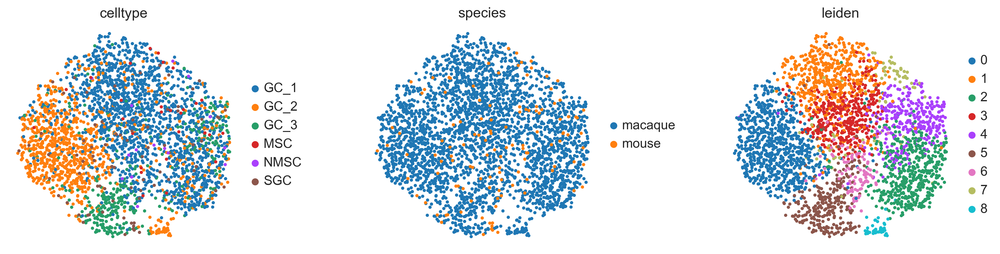

In [180]:
sc.pp.neighbors(adata_scvi, use_rep="X_scVI",n_neighbors=10)#,n_neighbors=90
sc.tl.leiden(adata_scvi,resolution=0.8,key_added = "leiden_scvi_0.8")
sc.tl.umap(adata_scvi,min_dist=0.3)
adata_scvi
sc.pl.umap(adata_scvi, color=['celltype','species','leiden'], wspace=0.4)

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\_settings.py:450: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


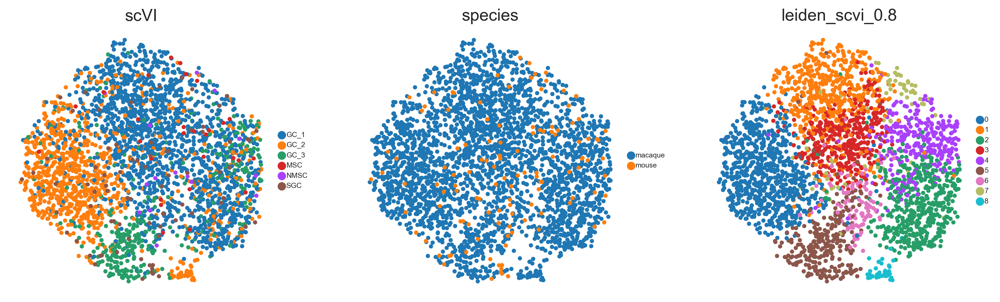

In [181]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(adata_scvi, color=['celltype','species','leiden_scvi_0.8'], wspace=0.2,
           size=50,
           legend_fontsize=6,ncols = 3,title='scVI',
           save='_gc_scvi.pdf'
          )

In [182]:
df = (
    adata_scvi.obs.groupby(["celltype_species", 'leiden_scvi_0.8'])
    .size()
    .unstack(fill_value=0)
)

G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\indexes\multi.py:643: DeprecationWarning: `cumproduct` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `cumprod` instead.
  codes = cartesian_product(codes)
G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\reshape\util.py:60: DeprecationWarning: `product` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `prod` instead.
  return [


In [183]:
df

leiden_scvi_0.8,0,1,2,3,4,5,6,7,8
celltype_species,,,,,,,,,
GC_1_macaque,85,414,331,321,197,46,86,49,2
GC_2_macaque,616,53,68,48,25,22,6,15,35
GC_3_macaque,28,14,61,12,66,185,8,5,2
MSC_mouse,1,5,5,4,8,1,2,2,0
NMSC_mouse,0,3,3,1,1,2,2,3,0
SGC_mouse,18,7,12,6,11,17,3,3,0


In [184]:
conf_mat = df / df.sum(axis=1).values[:, np.newaxis]
conf_mat

leiden_scvi_0.8,0,1,2,3,4,5,6,7,8
celltype_species,,,,,,,,,
GC_1_macaque,0.055519,0.270411,0.216199,0.209667,0.128674,0.030046,0.056172,0.032005,0.001306
GC_2_macaque,0.693694,0.059685,0.076577,0.054054,0.028153,0.024775,0.006757,0.016892,0.039414
GC_3_macaque,0.073491,0.036745,0.160105,0.031496,0.173228,0.485564,0.020997,0.013123,0.005249
MSC_mouse,0.035714,0.178571,0.178571,0.142857,0.285714,0.035714,0.071429,0.071429,0.000000
NMSC_mouse,0.000000,0.200000,0.200000,0.066667,0.066667,0.133333,0.133333,0.200000,0.000000
SGC_mouse,0.233766,0.090909,0.155844,0.077922,0.142857,0.220779,0.038961,0.038961,0.000000


In [185]:
import torch
sc.set_figure_params(figsize=(6, 6), frameon=False)
sns.set_theme()
torch.set_float32_matmul_precision("high")
#save_dir = tempfile.TemporaryDirectory()

%config InlineBackend.print_figure_kwargs={"facecolor": "w"}
%config InlineBackend.figure_format="retina"

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\_settings.py:450: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


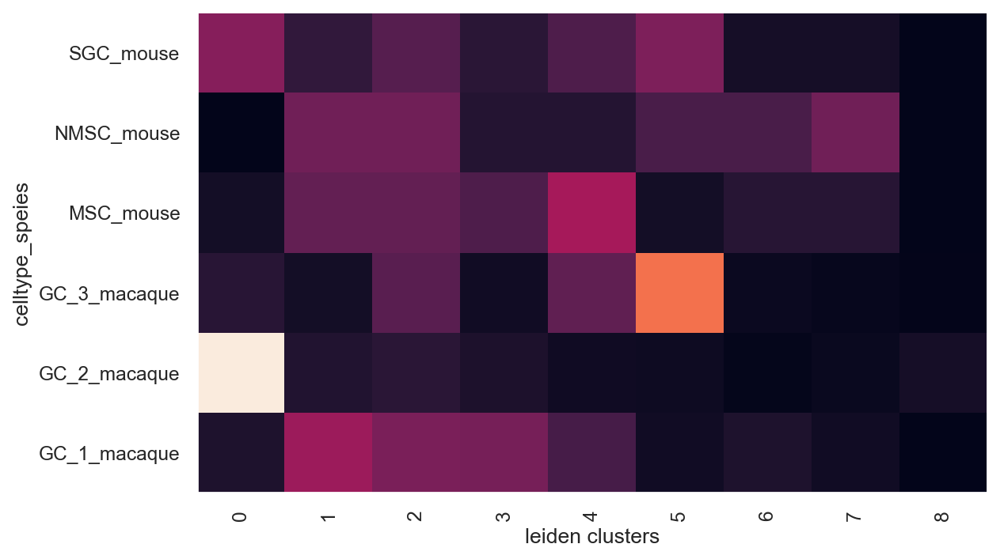

In [186]:
plt.figure(figsize=(8, 5))
_ = plt.pcolor(conf_mat)
_ = plt.xticks(np.arange(0.5, len(df.columns), 1), df.columns, rotation=90)
_ = plt.yticks(np.arange(0.5, len(df.index), 1), df.index)
plt.xlabel("leiden clusters")
plt.ylabel("celltype_speies")
plt.savefig('gc_scvi.jpeg', dpi=300)

In [165]:
# Normally we would need to run scVI first but we have already done that here
# model_scvi = scvi.model.SCVI(adata_scvi) etc.
model_scanvi = scvi.model.SCANVI.from_scvi_model(
    vae, labels_key='celltype', unlabeled_category="unlabelled"
)#unlabelled
print(model_scanvi)
model_scanvi.view_anndata_setup()

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\data\fields\_base_field.py:64: UserWarning: adata.layers[counts] does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


ScanVI Model with the following params: 
unlabeled_category: unlabelled, n_hidden: 128, n_latent: 30, n_layers: 3, dropout_rate: 0.1, dispersion: gene, 
gene_likelihood: zinb
Training status: Not Trained
Model's adata is minified?: False

Anndata setup with scvi-tools version 1.1.2.

Setup via `SCANVI.setup_anndata` with arguments:

{
│   'labels_key': 'celltype',
│   'unlabeled_category': 'unlabelled',
│   'layer': 'counts',
│   'batch_key': 'species',
│   'size_factor_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   2   │
│         n_cells          │ 2920  │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
│         n_labels         │   7   │
│          n_vars          │ 2000  │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │  adata.layers['counts']   │
│    batch     │ adata.obs['_scvi_batch']  │
│    labels    │ adata.obs['_scvi_labels'] │
└──────────────┴───────────────────────────┘

                   batch State Registry                    
┏━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃   Source Location    ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['species'] │  macaque   │          0          │
│                      │   mouse    │          1          │
└──────────────────────┴────────────┴─────────────────────┘

                   labels State Registry                    
┏━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃    Source Location    ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['celltype'] │    GC_1    │          0          │
│                       │    GC_2    │          1          │
│                       │    GC_3    │          2          │
│                       │    MSC     │          3          │
│                       │    NMSC    │          4          │
│                       │    SGC     │          5          │
│                       │ unlabelled │          6          │
└───────────────────────┴────────────┴─────────────────────┘

In [166]:
max_epochs_scanvi = int(np.min([10, np.max([2, round(max_epochs_scvi / 3.0)])]))
model_scanvi.train(max_epochs=max_epochs_scanvi)

INFO     Training for 10 epochs.                                                                                   


GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
G:\Miniconda3\envs\scvi-env\lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=47` in the `DataLoader` to improve performance.


Epoch 1/10:   0%|                                 | 0/10 [00:00<?, ?it/s]

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 2/10:  10%| | 1/10 [00:01<00:11,  1.30s/it, v_num=1, train_loss_ste

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 3/10:  20%|▏| 2/10 [00:02<00:10,  1.31s/it, v_num=1, train_loss_ste

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 4/10:  30%|▎| 3/10 [00:03<00:09,  1.30s/it, v_num=1, train_loss_ste

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 5/10:  40%|▍| 4/10 [00:05<00:08,  1.35s/it, v_num=1, train_loss_ste

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 6/10:  50%|▌| 5/10 [00:06<00:06,  1.36s/it, v_num=1, train_loss_ste

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 7/10:  60%|▌| 6/10 [00:08<00:05,  1.34s/it, v_num=1, train_loss_ste

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 8/10:  70%|▋| 7/10 [00:09<00:03,  1.32s/it, v_num=1, train_loss_ste

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 9/10:  80%|▊| 8/10 [00:10<00:02,  1.31s/it, v_num=1, train_loss_ste

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 10/10:  90%|▉| 9/10 [00:11<00:01,  1.30s/it, v_num=1, train_loss_st

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 10/10: 100%|█| 10/10 [00:13<00:00,  1.29s/it, v_num=1, train_loss_s

`Trainer.fit` stopped: `max_epochs=10` reached.


Epoch 10/10: 100%|█| 10/10 [00:13<00:00,  1.32s/it, v_num=1, train_loss_s


G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


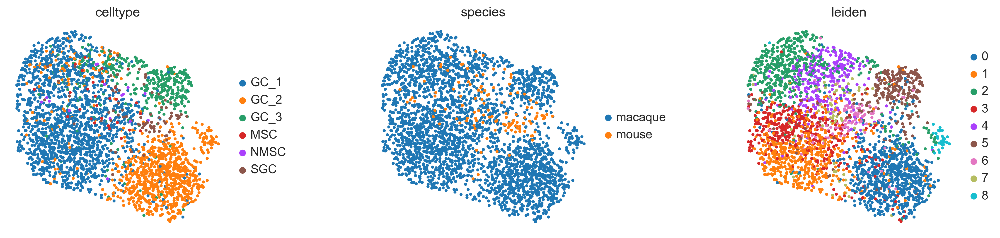

In [178]:
adata_scanvi = adata_scvi.copy()
adata_scanvi.obsm["X_scANVI"] = model_scanvi.get_latent_representation()
sc.pp.neighbors(adata_scanvi, use_rep="X_scANVI",n_neighbors=10)#n_neighbors=50
sc.tl.leiden(adata_scanvi,resolution=0.8,key_added = "leiden_scanvi_0.8")
sc.tl.umap(adata_scanvi,min_dist=0.4)#0.4
sc.pl.umap(adata_scanvi, color=['celltype','species','leiden'], wspace=0.5)

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\_settings.py:450: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


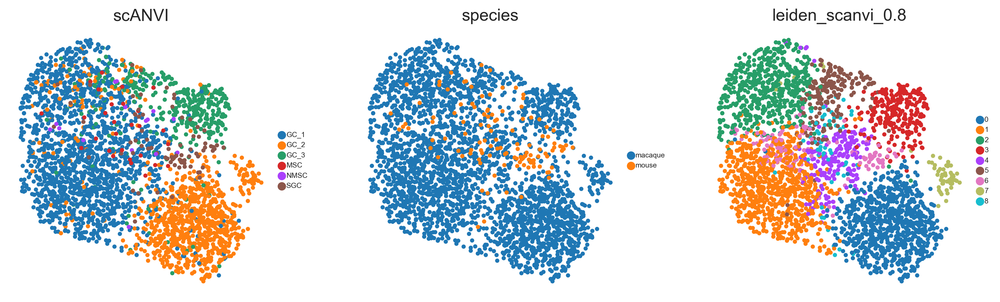

In [198]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(adata_scanvi, color=['celltype','species','leiden_scanvi_0.8'], wspace=0.2,
           size=50,
           legend_fontsize=6,ncols = 3,title='scANVI',
           save='_gc_scanvi.pdf'
          )

In [189]:
df = (
    adata_scanvi.obs.groupby(["celltype_species", 'leiden_scanvi_0.8'])
    .size()
    .unstack(fill_value=0)
)

G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\indexes\multi.py:643: DeprecationWarning: `cumproduct` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `cumprod` instead.
  codes = cartesian_product(codes)
G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\reshape\util.py:60: DeprecationWarning: `product` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `prod` instead.
  return [


In [190]:
conf_mat = df / df.sum(axis=1).values[:, np.newaxis]
conf_mat

leiden_scanvi_0.8,0,1,2,3,4,5,6,7,8
celltype_species,,,,,,,,,
GC_1_macaque,0.032005,0.444154,0.277596,0.007838,0.114958,0.047681,0.051600,0.000000,0.024167
GC_2_macaque,0.795045,0.034910,0.057432,0.009009,0.001126,0.016892,0.012387,0.063063,0.010135
GC_3_macaque,0.034121,0.031496,0.104987,0.580052,0.010499,0.212598,0.013123,0.002625,0.010499
MSC_mouse,0.000000,0.035714,0.285714,0.000000,0.214286,0.250000,0.107143,0.000000,0.107143
NMSC_mouse,0.000000,0.066667,0.200000,0.133333,0.066667,0.133333,0.200000,0.000000,0.200000
SGC_mouse,0.090909,0.038961,0.077922,0.181818,0.090909,0.168831,0.324675,0.012987,0.012987


In [191]:
import torch
sc.set_figure_params(figsize=(6, 6), frameon=False)
sns.set_theme()
torch.set_float32_matmul_precision("high")
#save_dir = tempfile.TemporaryDirectory()

%config InlineBackend.print_figure_kwargs={"facecolor": "w"}
%config InlineBackend.figure_format="retina"

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\_settings.py:450: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


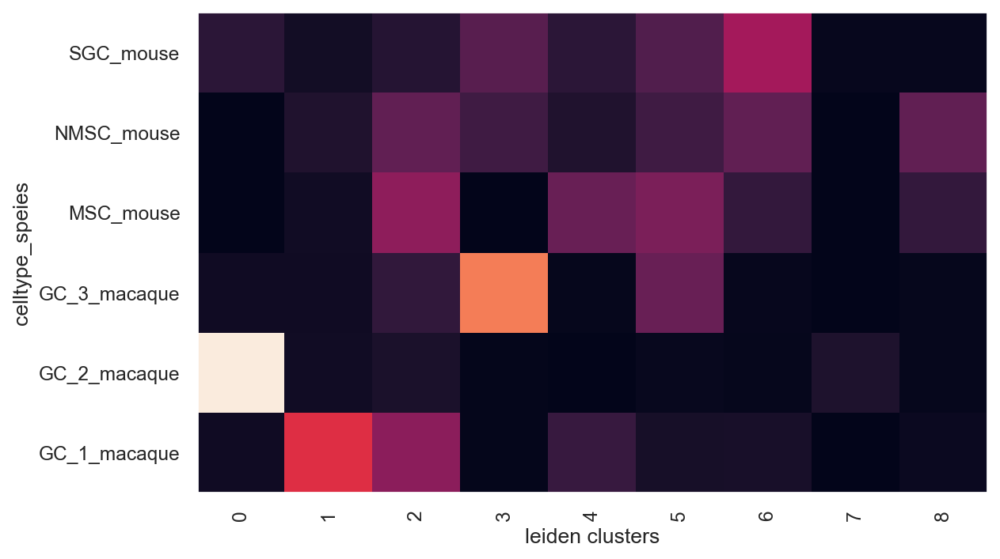

In [192]:
plt.figure(figsize=(8, 5))
_ = plt.pcolor(conf_mat)
_ = plt.xticks(np.arange(0.5, len(df.columns), 1), df.columns, rotation=90)
_ = plt.yticks(np.arange(0.5, len(df.index), 1), df.index)
plt.xlabel("leiden clusters")
plt.ylabel("celltype_speies")
plt.savefig('gc_scanvi.jpeg', dpi=300)

In [193]:
#An important parameter for BBKNN is the number of neighbors per batch. A suggested heuristic for this is to use 25 if there are more than 100,000 cells or the default of 3 if there are fewer than 100,000
neighbors_within_batch = 25 if gc_combined.n_obs > 100000 else 3
neighbors_within_batch

3

In [194]:
adata_bbknn = gc_combined.copy()
adata_bbknn.X = adata_bbknn.layers["logcounts"].copy()
sc.pp.pca(adata_bbknn)

In [195]:
bbknn.bbknn(
    adata_bbknn, batch_key='species', neighbors_within_batch=neighbors_within_batch
)
adata_bbknn

AnnData object with n_obs × n_vars = 2920 × 2000
    obs: 'nCount_RNA', 'nFeature_RNA', 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'batch', 'age', 'cluster3', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.8', 'seurat_clusters', 'integrated_snn_res.0.4', 'integrated_snn_res.0.3', 'seurat_clusters.new', 'celltype', 'celltype_species', 'species', 'orig.ident', 'pHB', 'pRP', 'pMT', 'SCT_snn_res.1.2', '_scvi_batch', '_scvi_labels', 'celltype_scanvi', 'C_scANVI'
    var: 'name', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_rank', 'variances', 'variances_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'species_colors', 'log1p', 'hvg', 'pca', 'neighbors', '

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


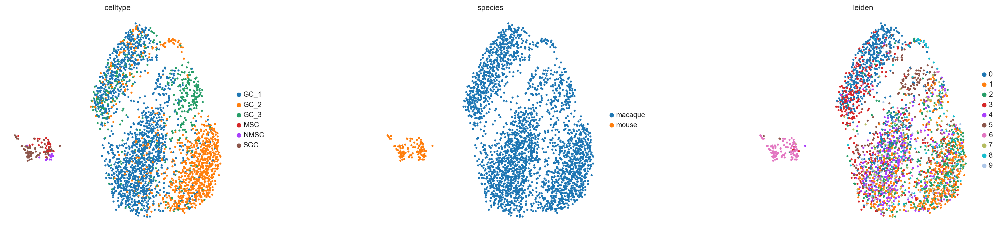

In [196]:
sc.pp.neighbors(adata_bbknn,n_neighbors=10)#n_neighbors=50
sc.tl.leiden(adata_bbknn,resolution=0.8,key_added = "leiden_bbknn_0.8")
sc.tl.umap(adata_bbknn,min_dist=0.4)#0.4
sc.pl.umap(adata_bbknn, color=['celltype','species','leiden'], wspace=0.5)

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\_settings.py:450: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


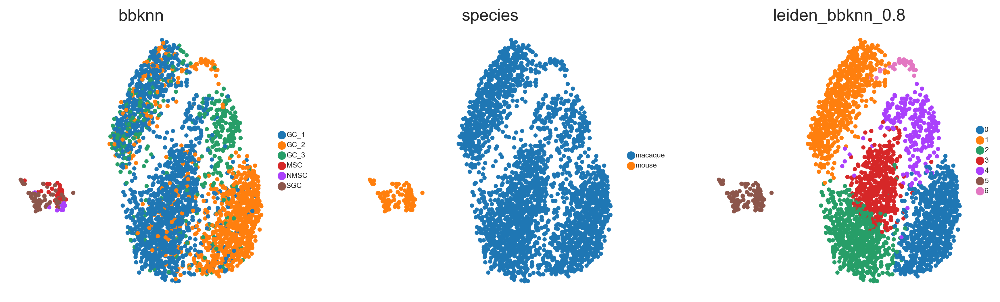

In [227]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(adata_bbknn, color=['celltype','species','leiden_bbknn_0.8'], wspace=0.2,
           size=50,
           legend_fontsize=6,ncols = 3,title='bbknn',
           save='_gc_bbknn.pdf'
          )

In [199]:
df = (
    adata_bbknn.obs.groupby(["celltype_species", 'leiden_bbknn_0.8'])
    .size()
    .unstack(fill_value=0)
)

G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\indexes\multi.py:643: DeprecationWarning: `cumproduct` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `cumprod` instead.
  codes = cartesian_product(codes)
G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\reshape\util.py:60: DeprecationWarning: `product` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `prod` instead.
  return [


In [200]:
conf_mat = df / df.sum(axis=1).values[:, np.newaxis]
conf_mat

leiden_bbknn_0.8,0,1,2,3,4,5,6
celltype_species,,,,,,,
GC_1_macaque,0.042456,0.291966,0.363815,0.259961,0.041803,0.0,0.000000
GC_2_macaque,0.747748,0.096847,0.057432,0.047297,0.011261,0.0,0.039414
GC_3_macaque,0.086614,0.333333,0.083990,0.041995,0.451444,0.0,0.002625
MSC_mouse,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000
NMSC_mouse,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000
SGC_mouse,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000


G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\_settings.py:450: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


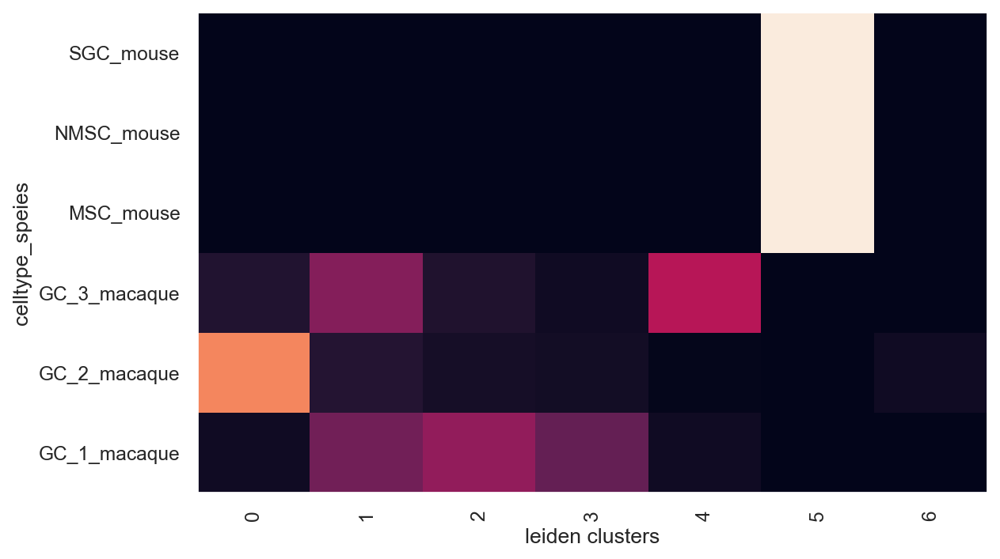

In [201]:
import torch
sc.set_figure_params(figsize=(6, 6), frameon=False)
sns.set_theme()
torch.set_float32_matmul_precision("high")
#save_dir = tempfile.TemporaryDirectory()

%config InlineBackend.print_figure_kwargs={"facecolor": "w"}
%config InlineBackend.figure_format="retina"
plt.figure(figsize=(8, 5))
_ = plt.pcolor(conf_mat)
_ = plt.xticks(np.arange(0.5, len(df.columns), 1), df.columns, rotation=90)
_ = plt.yticks(np.arange(0.5, len(df.index), 1), df.index)
plt.xlabel("leiden clusters")
plt.ylabel("celltype_speies")
plt.savefig('gc_bbknn.jpeg', dpi=300)

In [202]:
import scanpy.external as sce

In [203]:
adata_harmony = gc_combined.copy()

In [204]:
sce.pp.harmony_integrate(adata_harmony, 'species')

2024-09-23 15:00:58,601 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
G:\Miniconda3\envs\scvi-env\lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=12.
  warnings.warn(
2024-09-23 15:01:00,548 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-09-23 15:01:00,710 - harmonypy - INFO - Iteration 1 of 10
2024-09-23 15:01:01,557 - harmonypy - INFO - Iteration 2 of 10
2024-09-23 15:01:02,353 - harmonypy - INFO - Iteration 3 of 10
2024-09-23 15:01:03,142 - harmonypy - INFO - Iteration 4 of 10
2024-09-23 15:01:03,932 - harmonypy - INFO - Iteration 5 of 10
2024-09-23 15:01:04,561 - harmonypy - INFO - Iteration 6 of 10
2024-09-23 15:01:05,196 - harmonypy - INFO - Iteration 7 of 10
2024-09-23 15:01:05,681 - harmonypy - INFO - Iteration 8 of 10
2024-09-23 15:01:06,095

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


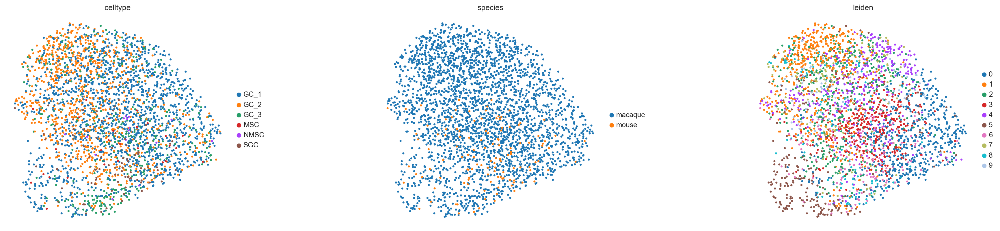

In [205]:
sc.pp.neighbors(adata_harmony, use_rep="X_pca_harmony",n_neighbors=10)
sc.tl.leiden(adata_harmony,resolution=0.8,key_added = "leiden_harmony_0.8")
sc.tl.umap(adata_harmony,min_dist=0.4)
sc.pl.umap(adata_harmony, color=['celltype','species','leiden'], wspace=0.5)

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\_settings.py:450: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


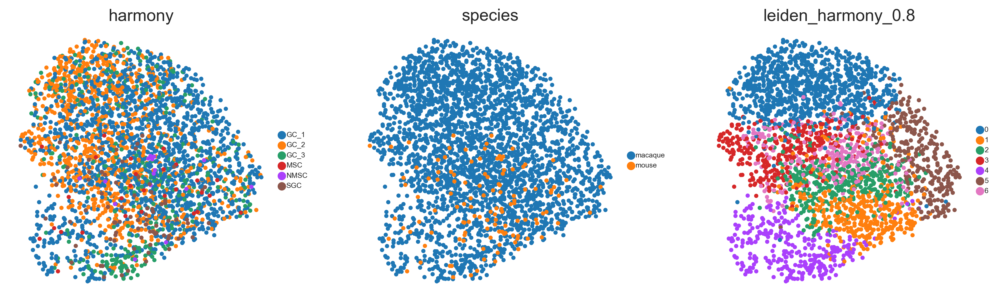

In [206]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(adata_harmony, color=['celltype','species','leiden_harmony_0.8'], wspace=0.2,
           size=50,
           legend_fontsize=6,ncols = 3,title='harmony',
           save='_gc_harmony.pdf'
          )

In [207]:
df = (
    adata_harmony.obs.groupby(["celltype_species", 'leiden_harmony_0.8'])
    .size()
    .unstack(fill_value=0)
)
conf_mat = df / df.sum(axis=1).values[:, np.newaxis]
conf_mat

G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\indexes\multi.py:643: DeprecationWarning: `cumproduct` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `cumprod` instead.
  codes = cartesian_product(codes)
G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\reshape\util.py:60: DeprecationWarning: `product` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `prod` instead.
  return [


leiden_harmony_0.8,0,1,2,3,4,5,6
celltype_species,,,,,,,
GC_1_macaque,0.285434,0.145003,0.132593,0.079033,0.101241,0.137165,0.119530
GC_2_macaque,0.431306,0.101351,0.128378,0.174550,0.046171,0.051802,0.066441
GC_3_macaque,0.254593,0.133858,0.141732,0.055118,0.228346,0.102362,0.083990
MSC_mouse,0.000000,0.214286,0.357143,0.107143,0.178571,0.071429,0.071429
NMSC_mouse,0.000000,0.000000,0.533333,0.000000,0.133333,0.133333,0.200000
SGC_mouse,0.000000,0.428571,0.168831,0.116883,0.194805,0.000000,0.090909


G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\_settings.py:450: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


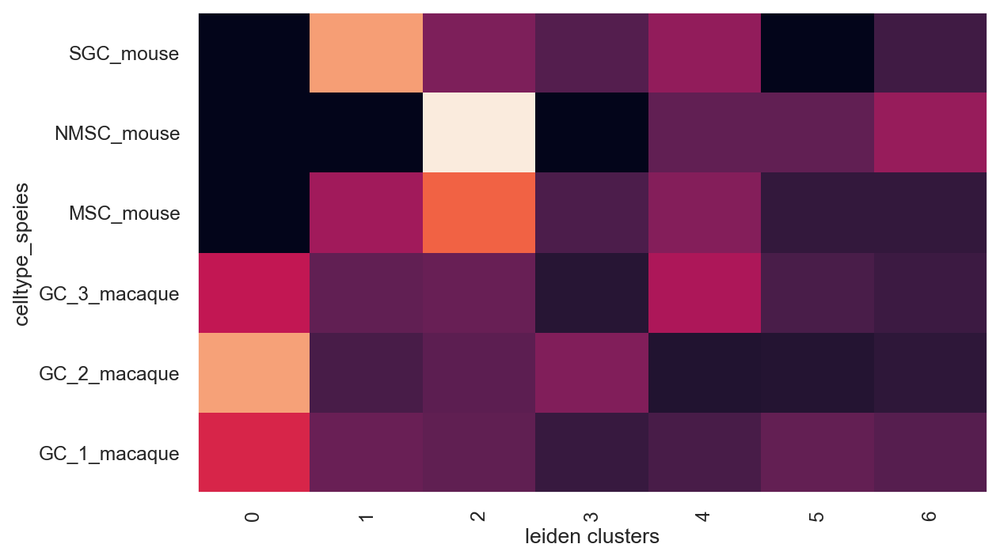

In [208]:
import torch
sc.set_figure_params(figsize=(6, 6), frameon=False)
sns.set_theme()
torch.set_float32_matmul_precision("high")
#save_dir = tempfile.TemporaryDirectory()

%config InlineBackend.print_figure_kwargs={"facecolor": "w"}
%config InlineBackend.figure_format="retina"
plt.figure(figsize=(8, 5))
_ = plt.pcolor(conf_mat)
_ = plt.xticks(np.arange(0.5, len(df.columns), 1), df.columns, rotation=90)
_ = plt.yticks(np.arange(0.5, len(df.index), 1), df.index)
plt.xlabel("leiden clusters")
plt.ylabel("celltype_speies")
plt.savefig('gc_harmony.jpeg', dpi=300)

In [209]:
adata_combat=gc_combined.copy()
adata_combat

AnnData object with n_obs × n_vars = 2920 × 2000
    obs: 'nCount_RNA', 'nFeature_RNA', 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'batch', 'age', 'cluster3', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.8', 'seurat_clusters', 'integrated_snn_res.0.4', 'integrated_snn_res.0.3', 'seurat_clusters.new', 'celltype', 'celltype_species', 'species', 'orig.ident', 'pHB', 'pRP', 'pMT', 'SCT_snn_res.1.2', '_scvi_batch', '_scvi_labels', 'celltype_scanvi', 'C_scANVI'
    var: 'name', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_rank', 'variances', 'variances_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'species_colors', 'log1p', 'hvg', 'pca', 'neighbors', '

In [210]:
sc.pp.combat(adata_combat, key='species')

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\preprocessing\_combat.py:340: RuntimeWarning: divide by zero encountered in divide
  (abs(g_new - g_old) / g_old).max(), (abs(d_new - d_old) / d_old).max()


G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\dtypes\cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated 

Highly variable genes: 273


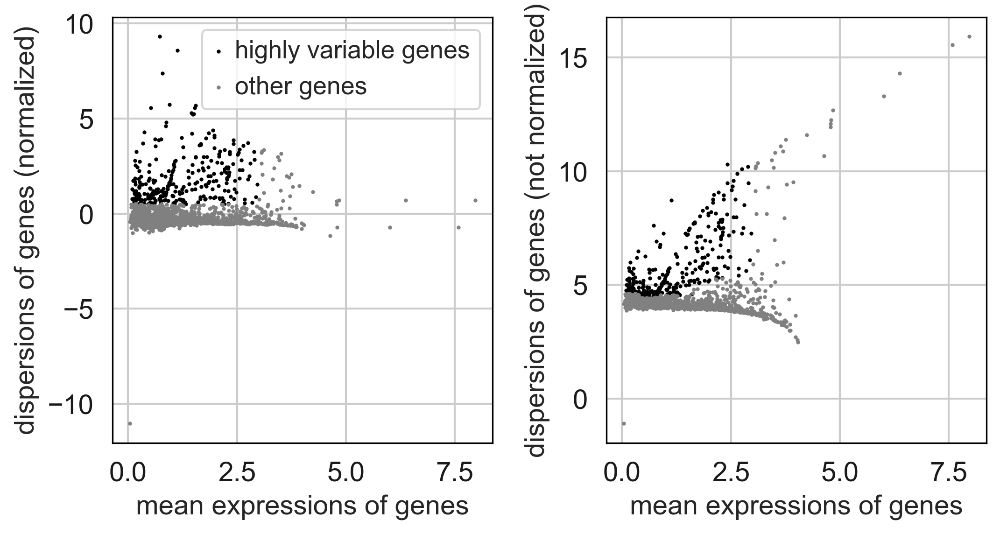

In [214]:
sc.pp.highly_variable_genes(adata_combat)
print("Highly variable genes: %d"%sum(adata_combat.var.highly_variable))
sc.pl.highly_variable_genes(adata_combat)

sc.pp.pca(adata_combat, n_comps=30, use_highly_variable=True, svd_solver='arpack')

sc.pp.neighbors(adata_combat,n_neighbors=10)
sc.tl.leiden(adata_combat,resolution=0.8,key_added = "leiden_combat_0.8")
sc.tl.umap(adata_combat)

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\_settings.py:450: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


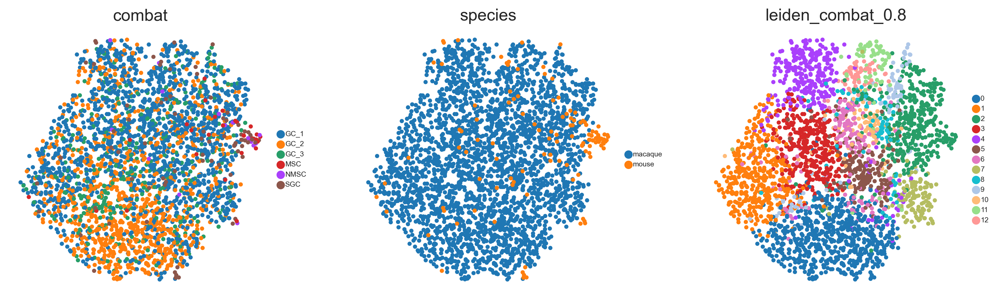

In [215]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(adata_combat, color=['celltype','species','leiden_combat_0.8'], wspace=0.2,
           size=50,
           legend_fontsize=6,ncols = 3,title='combat',
           save='_gc_combat.pdf'
          )

In [216]:
df = (
    adata_combat.obs.groupby(["celltype_species", 'leiden_combat_0.8'])
    .size()
    .unstack(fill_value=0)
)
conf_mat = df / df.sum(axis=1).values[:, np.newaxis]
conf_mat

G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\indexes\multi.py:643: DeprecationWarning: `cumproduct` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `cumprod` instead.
  codes = cartesian_product(codes)
G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\reshape\util.py:60: DeprecationWarning: `product` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `prod` instead.
  return [


leiden_combat_0.8,0,1,2,3,4,5,6,7,8,9,10,11,12
celltype_species,,,,,,,,,,,,,
GC_1_macaque,0.098628,0.142391,0.142391,0.120836,0.124755,0.078380,0.068583,0.054866,0.043762,0.019595,0.038537,0.037231,0.030046
GC_2_macaque,0.463964,0.126126,0.055180,0.099099,0.084459,0.042793,0.045045,0.021396,0.007883,0.014640,0.020270,0.010135,0.009009
GC_3_macaque,0.178478,0.133858,0.104987,0.165354,0.062992,0.076115,0.041995,0.041995,0.039370,0.104987,0.026247,0.010499,0.013123
MSC_mouse,0.000000,0.035714,0.714286,0.035714,0.000000,0.000000,0.000000,0.071429,0.071429,0.071429,0.000000,0.000000,0.000000
NMSC_mouse,0.000000,0.000000,0.666667,0.066667,0.066667,0.000000,0.000000,0.066667,0.000000,0.000000,0.066667,0.000000,0.066667
SGC_mouse,0.116883,0.038961,0.467532,0.051948,0.077922,0.077922,0.012987,0.038961,0.012987,0.051948,0.000000,0.012987,0.038961


G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\_settings.py:450: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


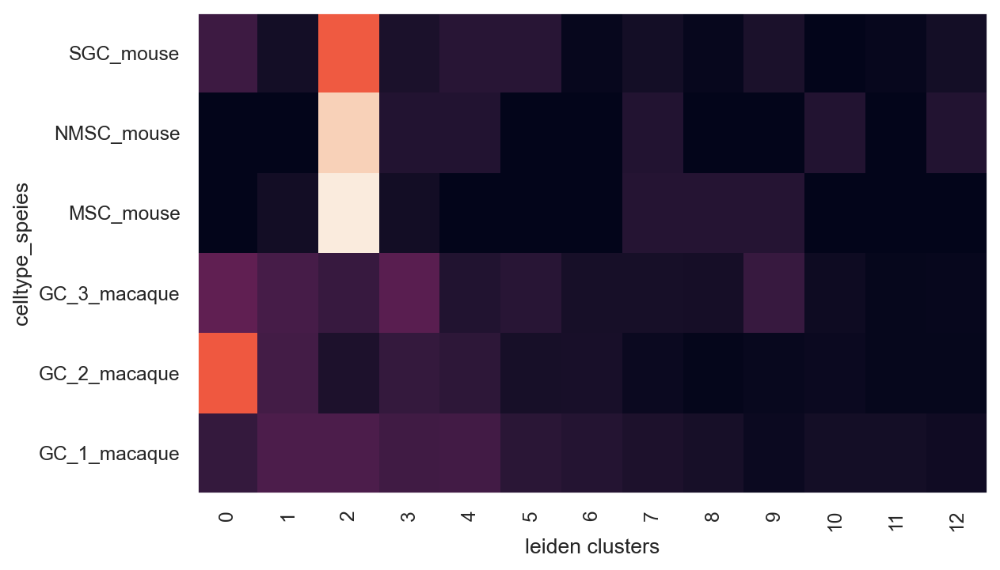

In [217]:
import torch
sc.set_figure_params(figsize=(6, 6), frameon=False)
sns.set_theme()
torch.set_float32_matmul_precision("high")
#save_dir = tempfile.TemporaryDirectory()

%config InlineBackend.print_figure_kwargs={"facecolor": "w"}
%config InlineBackend.figure_format="retina"
plt.figure(figsize=(8, 5))
_ = plt.pcolor(conf_mat)
_ = plt.xticks(np.arange(0.5, len(df.columns), 1), df.columns, rotation=90)
_ = plt.yticks(np.arange(0.5, len(df.index), 1), df.index)
plt.xlabel("leiden clusters")
plt.ylabel("celltype_speies")
plt.savefig('gc_combat.jpeg', dpi=300)

In [218]:
import scanorama

In [220]:
idx = gc_combined.obs.sort_values("species").index
adata_new = gc_combined[idx,]

In [221]:
sce.pp.scanorama_integrate(adata_new, 'species')

[[0. 1.]
 [0. 0.]]
Processing datasets macaque <=> mouse


G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\external\pp\_scanorama_integrate.py:131: ImplicitModificationWarning: Setting element `.obsm['X_scanorama']` of view, initializing view as actual.
  adata.obsm[adjusted_basis] = np.concatenate(integrated)


In [222]:
adata_scan=adata_new.copy()
adata_scan

AnnData object with n_obs × n_vars = 2920 × 2000
    obs: 'nCount_RNA', 'nFeature_RNA', 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'batch', 'age', 'cluster3', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.8', 'seurat_clusters', 'integrated_snn_res.0.4', 'integrated_snn_res.0.3', 'seurat_clusters.new', 'celltype', 'celltype_species', 'species', 'orig.ident', 'pHB', 'pRP', 'pMT', 'SCT_snn_res.1.2', '_scvi_batch', '_scvi_labels', 'celltype_scanvi', 'C_scANVI'
    var: 'name', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_rank', 'variances', 'variances_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'species_colors', 'log1p', 'hvg', 'pca', 'neighbors', '

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


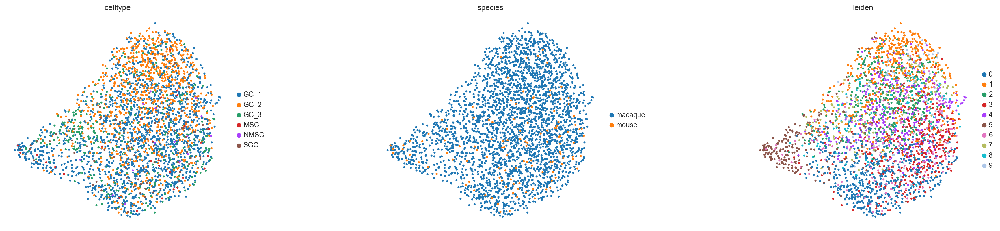

In [223]:
sc.pp.neighbors(adata_scan, use_rep="X_scanorama",n_neighbors=10)
sc.tl.leiden(adata_scan,resolution=0.8,key_added = "leiden_scan_0.8")
sc.tl.umap(adata_scan,min_dist=0.4)
sc.pl.umap(adata_scan, color=['celltype','species','leiden'], wspace=0.5)

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\_settings.py:450: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


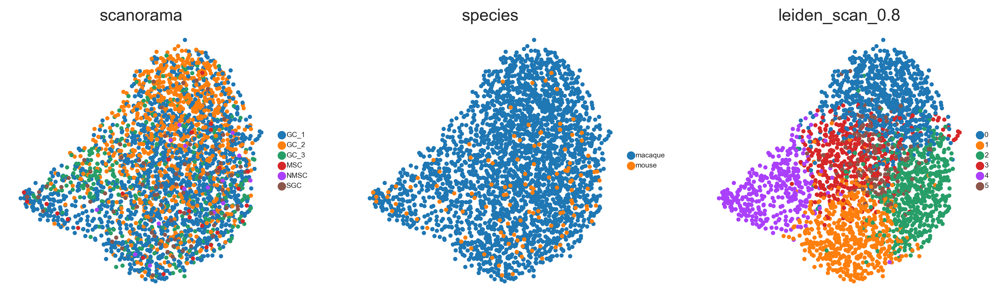

In [224]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(adata_scan, color=['celltype','species','leiden_scan_0.8'], wspace=0.2,
           size=50,
           legend_fontsize=6,ncols = 3,title='scanorama',
           save='_gc_scan.pdf'
          )

In [225]:
df = (
    adata_scan.obs.groupby(["celltype_species", 'leiden_scan_0.8'])
    .size()
    .unstack(fill_value=0)
)
conf_mat = df / df.sum(axis=1).values[:, np.newaxis]
conf_mat

G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\indexes\multi.py:643: DeprecationWarning: `cumproduct` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `cumprod` instead.
  codes = cartesian_product(codes)
G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\reshape\util.py:60: DeprecationWarning: `product` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `prod` instead.
  return [


leiden_scan_0.8,0,1,2,3,4,5
celltype_species,,,,,,
GC_1_macaque,0.188766,0.226649,0.231875,0.164598,0.133246,0.054866
GC_2_macaque,0.489865,0.122748,0.120495,0.128378,0.056306,0.082207
GC_3_macaque,0.178478,0.207349,0.181102,0.157480,0.249344,0.026247
MSC_mouse,0.142857,0.178571,0.392857,0.071429,0.214286,0.000000
NMSC_mouse,0.133333,0.200000,0.400000,0.066667,0.066667,0.133333
SGC_mouse,0.129870,0.324675,0.233766,0.090909,0.155844,0.064935


G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\_settings.py:450: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


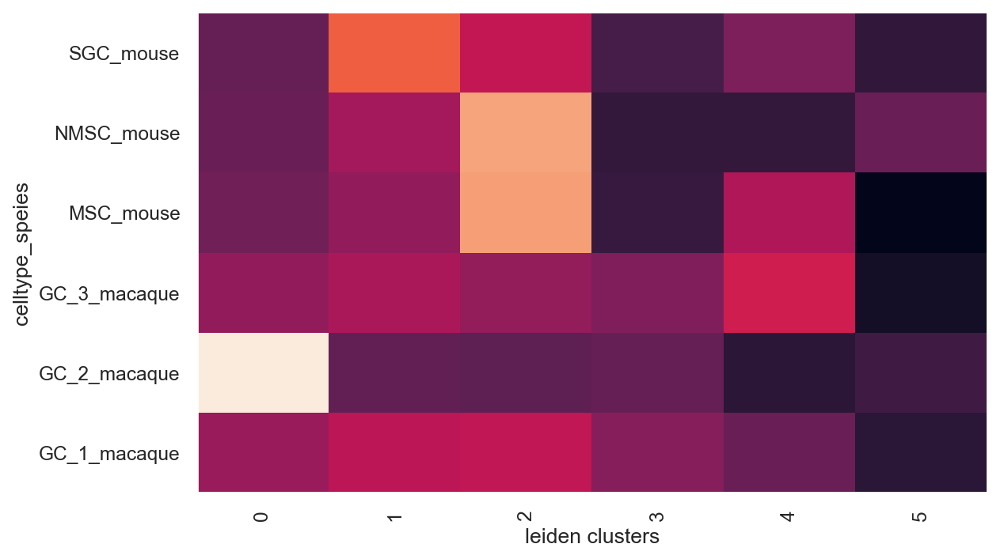

In [226]:
import torch
sc.set_figure_params(figsize=(6, 6), frameon=False)
sns.set_theme()
torch.set_float32_matmul_precision("high")
#save_dir = tempfile.TemporaryDirectory()

%config InlineBackend.print_figure_kwargs={"facecolor": "w"}
%config InlineBackend.figure_format="retina"
plt.figure(figsize=(8, 5))
_ = plt.pcolor(conf_mat)
_ = plt.xticks(np.arange(0.5, len(df.columns), 1), df.columns, rotation=90)
_ = plt.yticks(np.arange(0.5, len(df.index), 1), df.index)
plt.xlabel("leiden clusters")
plt.ylabel("celltype_speies")
plt.savefig('gc_scan.jpeg', dpi=300)